In [1]:
# Installing packages 
!pip install pandas
!pip install numpy 
!pip install matplotlib
!pip install glob
!pip install librosa

# importing libraries 
import pandas as pd 
import numpy as np 
import matplotlib.pylab as plt 
from glob import glob  
import librosa
import librosa.display
import IPython.display as ipd
import IPython    
import zipfile


[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip
ERROR: Could not find a version that satisfies the requirement glob (from versions: none)
ERROR: No matching distribution found for glob

[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [480]:

# Installing csv files 

R1_mon= pd.read_csv("release1-monolog-csv.csv")
R2_con = pd.read_csv("release2-Conversation-csv.csv")
R2_Read= pd.read_csv("release2-Reading-csv.csv")
R2_mon= pd.read_csv("release2-Monologe-csv.csv")    



In [481]:
#From ZIP file installing the audios 

#Release 1 monologue
with zipfile.ZipFile("AllAudioWav.R1.zip", 'r') as zip_ref:
    zip_ref.extractall()

#Release 2 monologue 
with zipfile.ZipFile("AllMonoWavAudioOnly.zip", 'r') as zip_ref:
    zip_ref.extractall()
#Release 2 Conversation 
with zipfile.ZipFile("AllConvWavAudioOnly.zip", 'r') as zip_ref:
    zip_ref.extractall()
#Release 2 Reading 
with zipfile.ZipFile("AllReadWavAudioOnly.zip", 'r') as zip_ref:
    zip_ref.extractall()

In [482]:
import os 
#all the aduios
extracted_files=os.listdir()
wav_files = [file for file in extracted_files if file.endswith('.wav')]
print(wav_files)

['F_0050_10y9m_1.wav', 'F_0101_10y4m_1.wav', 'F_0101_13y1m_1.wav', 'F_0101_14y8m_1.wav', 'F_0101_14y8m_2.wav', 'F_0101_15y2m_1.wav', 'F_0101_15y2m_2.wav', 'F_0101_17y2m_1.wav', 'F_0101_17y3m_1.wav', 'F_0111_09y6m_1.wav', 'F_0111_9y6m_1.wav', 'F_0126_6y9m_1.wav', 'F_0128_7y9m_1.wav', 'F_0142_11y3m_1.wav', 'F_0142_11y5m_1.wav', 'F_0142_11y7m_1.wav', 'F_0142_12y0m_1.wav', 'F_0142_12y4m_1.wav', 'F_0558_09y3m_1.wav', 'F_0558_10y0m_1.wav', 'F_0560_10y0m_1.wav', 'F_0560_11y7m_1.wav', 'F_0811_10y4m_1.wav', 'F_0811_10y6m_1.wav', 'F_0818_12y4m_1.wav', 'F_0818_14y2m_1.wav', 'F_0818_14y2m_2.wav', 'F_0818_15y11m_1.wav', 'F_0818_16y1m_1.wav', 'F_0818_16y1m_2.wav', 'F_0879_12y5m_1.wav', 'F_0987_12y7m_1.wav', 'F_0987_12y8m_1.wav', 'F_0988_12y8m_1.wav', 'F_0988_13y6m_1.wav', 'F_1039_09y3m_1.wav', 'F_1116_09y6m_1.wav', 'F_1116_9y6m_1.wav', 'F_1201_12y11m_1.wav', 'F_1211_11y3m_1.wav', 'M_0014_10y10m_1.wav', 'M_0014_10y10m_2.wav', 'M_0014_11y1m_1.wav', 'M_0014_11y3m_1.wav', 'M_0014_11y7m_1.wav', 'M_0014_1

In [483]:
#extracting the file names from each csv file(each situation)


col1_R1_mon=  R1_mon.iloc[:,0]
col1_R2_mon= R2_mon.iloc[:,0]
col1_R2_con= R2_con.iloc[:,0]
col1_R2_red= R2_Read.iloc[:,0] 

In [484]:
print(len(wav_files))

304



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


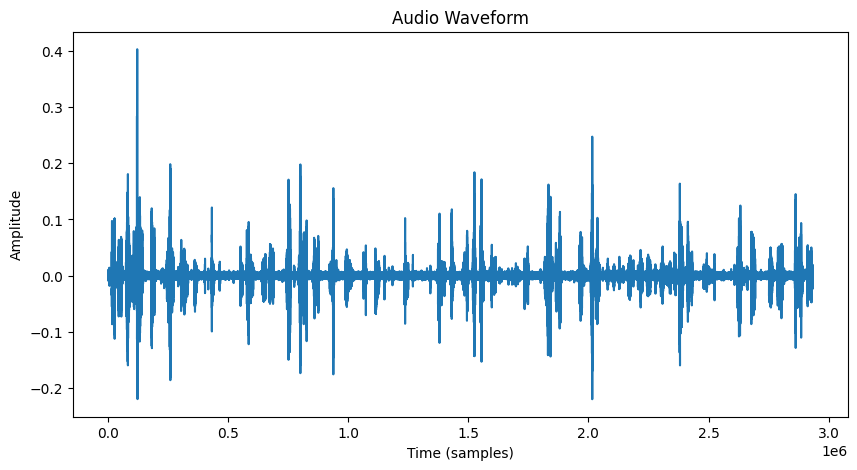

In [6]:
#One audio example before cleaning

!pip install setuptools 
import matplotlib.pyplot as plt 

# listening  to one audio example: 
 
import matplotlib.pyplot as plt

#plot the original audio before cleaning up
audio1,sr= librosa.load("M_0104_13y3m_1.wav")

plt.figure(figsize=(10, 5))
plt.plot(audio1)
plt.xlabel('Time (samples)')
plt.ylabel('Amplitude')
plt.title('Audio Waveform')
plt.show()

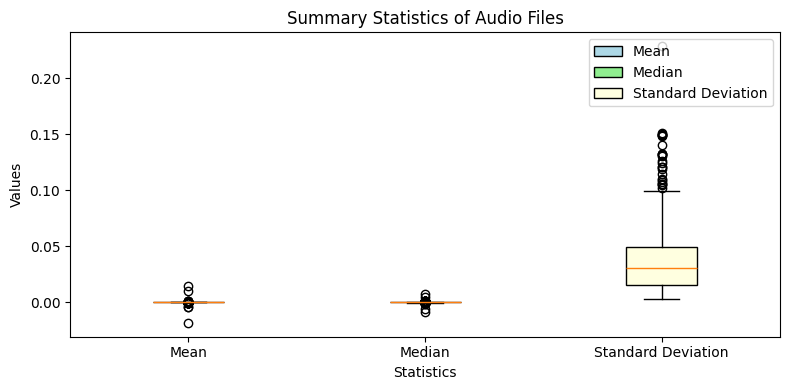

In [7]:
# summerinzing all the audios 
# Function to calculate descriptive statistics for each audio file
def calculate_statistics(audio_files):
    statistics = []
    for audio_file in audio_files:
        try:
            # Load audio data
            y, sr = librosa.load(audio_file, sr=None)
            
            # Calculate statistics
            mean = np.mean(y)
            median = np.median(y)
            std = np.std(y)
            
            # Append statistics to list
            statistics.append({
                'Audio File': audio_file,
                'Mean': mean,
                'Median': median,
                'Standard Deviation': std
            })
        except Exception as e:
            print(f"Error loading {audio_file}: {str(e)}")
    return pd.DataFrame(statistics)

# Calculate descriptive statistics
statistics = calculate_statistics(wav_files)

# Plot boxplot graph
plt.figure(figsize=(8, 4))
plt.title('Summary Statistics of Audio Files')
plt.xlabel('Statistics')
plt.ylabel('Values')

# Create boxplot
boxplot = plt.boxplot(statistics[['Mean', 'Median', 'Standard Deviation']].values, patch_artist=True)

# Add x-axis labels
plt.xticks([1, 2, 3], ['Mean', 'Median', 'Standard Deviation'])

# Fill boxplot with colors
colors = ['lightblue', 'lightgreen', 'lightyellow']
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)

# Add legend
plt.legend(boxplot['boxes'], ['Mean', 'Median', 'Standard Deviation'], loc='upper right')

# Show plot
plt.tight_layout()
plt.show()

Error processing M_1040_11y3m_1.wav: Audio buffer is not finite everywhere


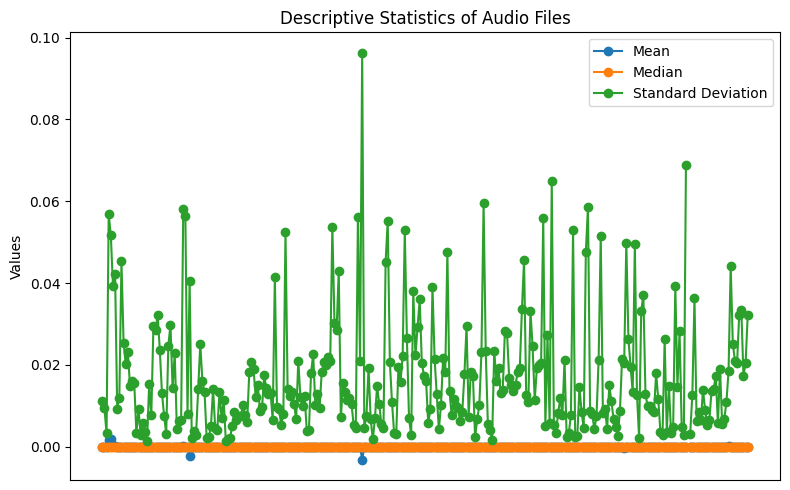

In [432]:

# Function to calculate descriptive statistics for a single audio file
def calculate_statistics(audio_file):
    try:
        # Load audio data
        y, sr = librosa.load(audio_file, sr=None)
        
        # Calculate statistics
        mean = np.mean(y)
        median = np.median(y)
        std = np.std(y)
        
        return mean, median, std
    except Exception as e:
        print(f"Error processing {audio_file}: {str(e)}")
        return None, None, None

# Calculate descriptive statistics for all audio files
statistics = [calculate_statistics(audio_file) for audio_file in wav_files]

# Separate statistics
means, medians, stds = zip(*statistics)

# Plot descriptive statistics
plt.figure(figsize=(8, 5))
plt.title('Descriptive Statistics of Audio Files')
plt.ylabel('Values')

# Plot mean, median, and standard deviation for each audio file
plt.plot(range(len(wav_files)), means, label='Mean', marker='o')
plt.plot(range(len(wav_files)), medians, label='Median', marker='o')
plt.plot(range(len(wav_files)), stds, label='Standard Deviation', marker='o')

# Hide x-axis tick labels
plt.xticks([])

# Show legend
plt.legend()

# Show plot
plt.tight_layout()
plt.show()

In [9]:
#cleaning the audios

In [10]:
pip install noisereduce


[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
# Apply for one audio

In [12]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from noisereduce import reduce_noise

# Load the audio file
audio_path = "M_0104_13y3m_1.wav"
y, sr = librosa.load(audio_path, sr=None)  # Load with the original sampling rate

# Listen to the audio
import IPython.display as ipd
ipd.Audio(audio_path)


C:\Users\HP\AppData\Local\Temp\ipykernel_13604\3949071882.py:3: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(y), ref=np.max), y_axis='log', x_axis='time', sr=sr)


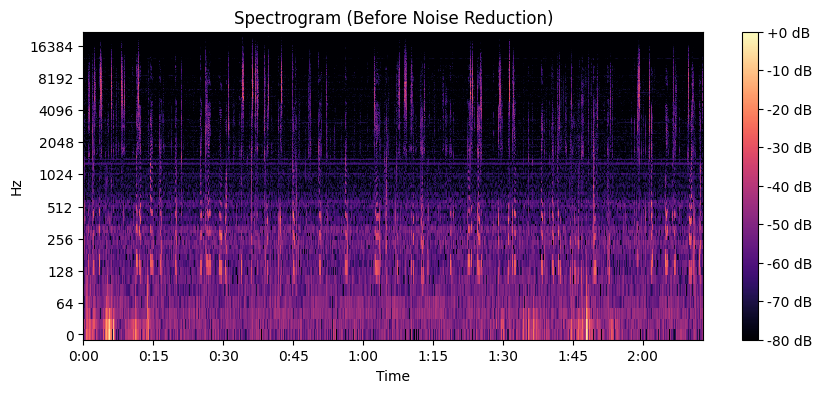

C:\Users\HP\AppData\Local\Temp\ipykernel_13604\3949071882.py:13: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(y_reduced), ref=np.max), y_axis='log', x_axis='time', sr=sr)


Text(0.5, 1.0, 'Spectrogram (After Noise Reduction)')

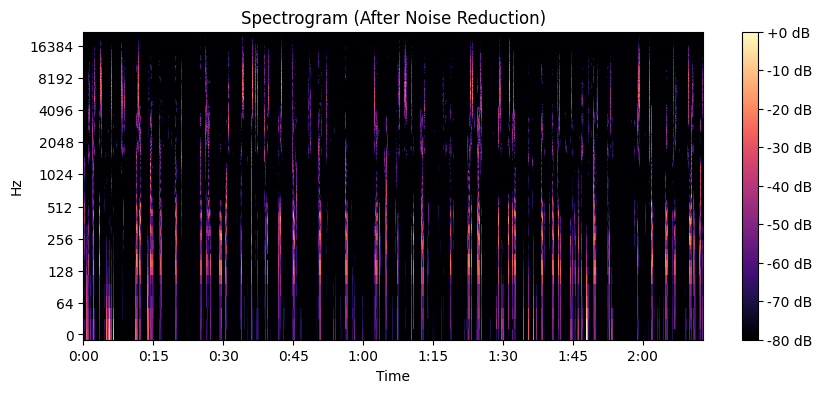

In [13]:

# Plot the spectrogram to visualize the audio
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(y), ref=np.max), y_axis='log', x_axis='time', sr=sr)
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (Before Noise Reduction)')
plt.show()

# Perform noise reduction
y_reduced = reduce_noise(y, sr)

# Plot the spectrogram after noise reduction
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(y_reduced), ref=np.max), y_axis='log', x_axis='time', sr=sr)
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (After Noise Reduction)')


In [14]:
#listening to the example audio after cleaning
import IPython.display as ipd

ipd.Audio(y_reduced, rate=sr)

In [15]:
ipd.Audio("M_1040_11y3m_1.wav")

In [16]:
#Generelizing the cleaning method to all the audios

from noisereduce import reduce_noise
from scipy.io import wavfile  

def clean_audio(audio_filename):
    # Load the audio file
    y, sr = librosa.load(audio_filename, sr=None)  # Load with the original sampling rate
    
    # Perform noise reduction
    y_reduced = reduce_noise(y, sr)
    
    # Save the cleaned audio with the same filename as the original
    wavfile.write(audio_filename, sr, y_reduced)
    print("Cleaned audio saved to:", audio_filename)

# Get all WAV audio files in the current directory
audio_files = [file for file in os.listdir() if file.endswith(".wav")]

# Process each audio file
for audio_filename in audio_files:
    clean_audio(audio_filename)


Cleaned audio saved to: F_0050_10y9m_1.wav
Cleaned audio saved to: F_0101_10y4m_1.wav
Cleaned audio saved to: F_0101_13y1m_1.wav
Cleaned audio saved to: F_0101_14y8m_1.wav
Cleaned audio saved to: F_0101_14y8m_2.wav
Cleaned audio saved to: F_0101_15y2m_1.wav
Cleaned audio saved to: F_0101_15y2m_2.wav
Cleaned audio saved to: F_0101_17y2m_1.wav
Cleaned audio saved to: F_0101_17y3m_1.wav
Cleaned audio saved to: F_0111_09y6m_1.wav
Cleaned audio saved to: F_0111_9y6m_1.wav
Cleaned audio saved to: F_0126_6y9m_1.wav
Cleaned audio saved to: F_0128_7y9m_1.wav
Cleaned audio saved to: F_0142_11y3m_1.wav
Cleaned audio saved to: F_0142_11y5m_1.wav
Cleaned audio saved to: F_0142_11y7m_1.wav
Cleaned audio saved to: F_0142_12y0m_1.wav
Cleaned audio saved to: F_0142_12y4m_1.wav
Cleaned audio saved to: F_0558_09y3m_1.wav
Cleaned audio saved to: F_0558_10y0m_1.wav
Cleaned audio saved to: F_0560_10y0m_1.wav
Cleaned audio saved to: F_0560_11y7m_1.wav
Cleaned audio saved to: F_0811_10y4m_1.wav
Cleaned audio 

C:\Users\HP\AppData\Local\Programs\Python\Python312\Lib\site-packages\noisereduce\spectralgate\nonstationary.py:71: RuntimeWarning: invalid value encountered in divide
  sig_mult_above_thresh = (abs_sig_stft - sig_stft_smooth) / sig_stft_smooth


Cleaned audio saved to: M_1040_11y3m_1.wav
Cleaned audio saved to: M_1040_11y5m_1.wav
Cleaned audio saved to: M_1040_11y8m_1.wav
Cleaned audio saved to: M_1040_12y6m_1.wav
Cleaned audio saved to: M_1064_47y0m_1.wav
Cleaned audio saved to: M_1097_26y0m_1.wav
Cleaned audio saved to: M_1098_25y0m_1.wav
Cleaned audio saved to: M_1099_25y0m_1.wav
Cleaned audio saved to: M_1100_28y0m_1.wav
Cleaned audio saved to: M_1101_35y0m_1.wav
Cleaned audio saved to: M_1102_24y0m_1.wav
Cleaned audio saved to: M_1103_20y0m_1.wav
Cleaned audio saved to: M_1104_40y0m_1.wav
Cleaned audio saved to: M_1105_21y0m_1.wav
Cleaned audio saved to: M_1106_25y0m_1.wav
Cleaned audio saved to: M_1107_38y0m_1.wav
Cleaned audio saved to: M_1112_09y9m.1.wav
Cleaned audio saved to: M_1114_09y10m.1.wav
Cleaned audio saved to: M_1202_10y11m_1.wav
Cleaned audio saved to: M_1202_10y7m_1.wav
Cleaned audio saved to: M_1205_13y1m_1.wav
Cleaned audio saved to: M_1206_12y3m_1.wav
Cleaned audio saved to: M_1207_13y5m_1.wav
Cleaned a

Error loading M_1040_11y3m_1.wav: Audio buffer is not finite everywhere


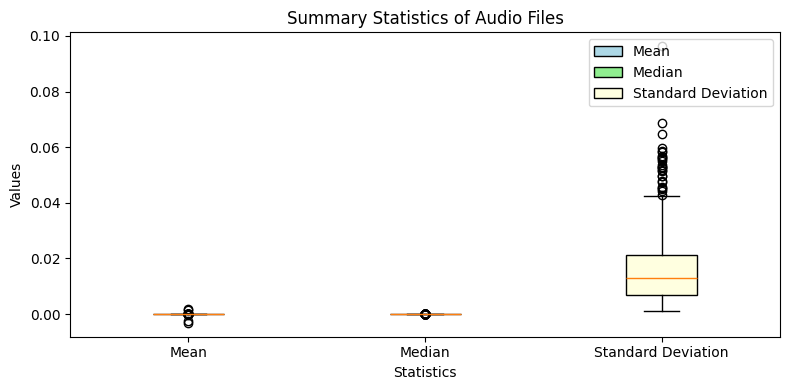

In [17]:
# summerinzing all the audios after cleaning
# Function to calculate descriptive statistics for each audio file
def calculate_statistics(audio_files):
    statistics = []
    for audio_file in audio_files:
        try:
            # Load audio data
            y, sr = librosa.load(audio_file, sr=None)
            
            # Calculate statistics
            mean = np.mean(y)
            median = np.median(y)
            std = np.std(y)
            
            # Append statistics to list
            statistics.append({
                'Audio File': audio_file,
                'Mean': mean,
                'Median': median,
                'Standard Deviation': std
            })
        except Exception as e:
            print(f"Error loading {audio_file}: {str(e)}")
    return pd.DataFrame(statistics)

# Calculate descriptive statistics
statistics = calculate_statistics(wav_files)

# Plot boxplot graph
plt.figure(figsize=(8, 4))
plt.title('Summary Statistics of Audio Files')
plt.xlabel('Statistics')
plt.ylabel('Values')
# Create boxplot
boxplot = plt.boxplot(statistics[['Mean', 'Median', 'Standard Deviation']].values, patch_artist=True)

# Add x-axis labels
plt.xticks([1, 2, 3], ['Mean', 'Median', 'Standard Deviation'])

# Fill boxplot with colors
colors = ['lightblue', 'lightgreen', 'lightyellow']
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)

# Add legend
plt.legend(boxplot['boxes'], ['Mean', 'Median', 'Standard Deviation'], loc='upper right')

# Show plot
plt.tight_layout()
plt.show()

Error processing M_1040_11y3m_1.wav: Audio buffer is not finite everywhere


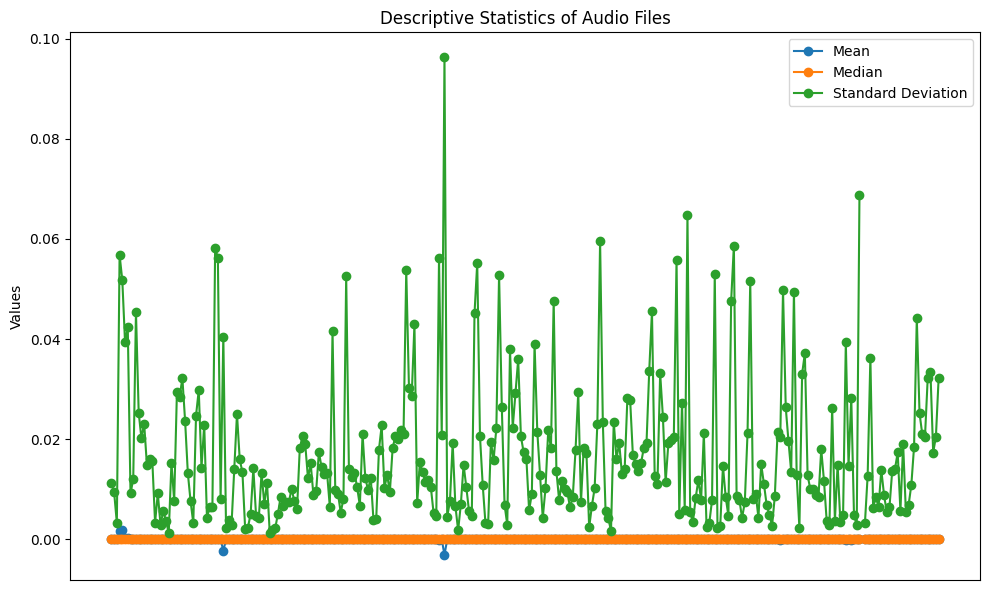

In [18]:

# Function to calculate descriptive statistics for a single audio file after cleaning
def calculate_statistics(audio_file):
    try:
        # Load audio data
        y, sr = librosa.load(audio_file, sr=None)
        
        # Calculate statistics
        mean = np.mean(y)
        median = np.median(y)
        std = np.std(y)
        
        return mean, median, std
    except Exception as e:
        print(f"Error processing {audio_file}: {str(e)}")
        return None, None, None

# Calculate descriptive statistics for all audio files
statistics = [calculate_statistics(audio_file) for audio_file in wav_files]

# Separate statistics
means, medians, stds = zip(*statistics)

# Plot descriptive statistics
plt.figure(figsize=(10, 6))
plt.title('Descriptive Statistics of Audio Files')
plt.ylabel('Values')

# Plot mean, median, and standard deviation for each audio file
plt.plot(range(len(wav_files)), means, label='Mean', marker='o')
plt.plot(range(len(wav_files)), medians, label='Median', marker='o')
plt.plot(range(len(wav_files)), stds, label='Standard Deviation', marker='o')

# Hide x-axis tick labels
plt.xticks([])

# Show legend
plt.legend()

# Show plot
plt.tight_layout()
plt.show()

#Response variable

In stuttering analysis, we often divide the audio recordings into smaller segments, 
which can correspond to individual words, phrases, or sentences. 
Each of these segments is then analyzed separately to assess stuttering 
severity or detect stuttering events.

In [19]:
#stuttering severity score for each audio recording based on
#the analysis of stuttering events within its segments.

In [20]:
# each audio:
#1. dividing into segment
#2. function that creates list of segmment scores
#3. function that make from that list one score for the audio segment
#4. function that handle each audio
#5. function that handle all the audios

In [21]:
pip install praat-parselmouth

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [22]:
#with normlizing

In [23]:
import librosa
import numpy as np
import parselmouth

# Function to calculate pitch using Praat
def calculate_pitch(segment, sampling_rate):
    sound = parselmouth.Sound(segment, sampling_frequency=sampling_rate)
    pitch = sound.to_pitch()
    mean_pitch = pitch.selected_array['frequency'].mean()
    return mean_pitch

# Function to calculate intensity
def calculate_intensity(segment):
    energy = np.square(segment)
    rms_amplitude = np.sqrt(np.mean(energy))
    std_deviation = np.std(segment)
    return rms_amplitude

# Function to calculate disfluency duration
def calculate_disfluency_duration(segment, sampling_rate, pause_threshold=0.05):
    energy_env = np.abs(librosa.core.stft(segment))
    energy_per_frame = np.mean(energy_env, axis=0)
    pauses = np.where(energy_per_frame < pause_threshold)[0]
    pause_times = librosa.frames_to_time(pauses, sr=sampling_rate)
    disfluency_duration = np.sum(np.diff(pause_times))
    return disfluency_duration

import librosa
import numpy as np

def calculate_spectral_feature_scalar(segment, sampling_rate):
    # Compute short-time Fourier transform (STFT)
    stft = librosa.stft(segment)

    # Compute power spectrogram
    power_spectrogram = np.abs(stft)**2

    # Compute Mel-frequency cepstral coefficients (MFCCs)
    mfccs = librosa.feature.mfcc(S=librosa.power_to_db(power_spectrogram),
                                  sr=sampling_rate,
                                  n_mfcc=13)

    # Calculate the mean of MFCCs across all coefficients
    mfccs_mean = np.mean(mfccs)

    return mfccs_mean



In [24]:
# Function to assess severity of stuttering based on extracted features
def assess_stuttering_severity(pitch, intensity, disfluency_duration, spectral_feature_scalar):
    # Define weights for each feature (you can adjust these based on your analysis)
    pitch_weight = 0.25
    intensity_weight = 0.25
    disfluency_duration_weight = 0.25
    spectral_feature_weight = 0.25
    
    # Combine features using weighted sum
    combined_score = (pitch * pitch_weight +
                      intensity * intensity_weight +
                      disfluency_duration * disfluency_duration_weight +
                      spectral_feature_scalar * spectral_feature_weight)
    
    # Normalize the combined score (optional)
    min_score = min(pitch, intensity, disfluency_duration, spectral_feature_scalar)
    max_score = max(pitch, intensity, disfluency_duration, spectral_feature_scalar)
    normalized_score = (combined_score - min_score) / (max_score - min_score)
    
    return normalized_score


In [25]:
def calculate_audio_stuttering_score(audio_file, max_segment_duration=5):
    try:
        # Load the audio file
        y, sr = librosa.load(audio_file, sr=None)

        # Check if the audio was loaded successfully
        if y is None:
            print("Error: Unable to load audio file.")
            return None

        # Calculate the total duration of the audio
        total_duration = librosa.get_duration(y=y, sr=sr)

        # Calculate the number of segments based on the maximum segment duration
        num_segments = int(np.ceil(total_duration / max_segment_duration))

        # Placeholder list to store feature scores for each segment
        segment_scores = []

        # Iterate over each segment
        for i in range(num_segments):
            # Calculate the start and end time of the segment
            segment_start = i * max_segment_duration
            segment_end = min((i + 1) * max_segment_duration, total_duration)

            # Extract the segment from the audio
            segment = y[int(segment_start * sr):int(segment_end * sr)]

            # Calculate pitch
            pitch = calculate_pitch(segment, sr)
            # Calculate intensity
            intensity = calculate_intensity(segment)

            # Calculate disfluency duration
            disfluency_duration = calculate_disfluency_duration(segment, sr)

            # Calculate spectral feature scalar
            spectral_feature_scalar = calculate_spectral_feature_scalar(segment, sr)

            # Define weights for each feature
            weights = [0.25, 0.25, 0.25, 0.25]  # Equal weights for demonstration purposes

            # Aggregate the features into a segment score using weighted combination
            normalized_segment_score = assess_stuttering_severity(pitch, intensity, disfluency_duration, spectral_feature_scalar)

            # Append the segment score to the list
            segment_scores.append(normalized_segment_score)

        # Calculate the overall score for the audio file
        overall_score = np.mean(segment_scores)

        return overall_score

    except Exception as e:
        return None

In [26]:
calculate_audio_stuttering_score("M_0048_11y6m_2.wav")

0.6182042098848883

In [27]:

audio_scores = []
for audio_file in wav_files: 
    audio_score = calculate_audio_stuttering_score(audio_file)
    audio_scores.append(audio_score)
  
   

# Print or use the scores as needed
print("Stuttering Severity Scores:", audio_scores)


C:\Users\HP\AppData\Local\Programs\Python\Python312\Lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=2048 is too large for input signal of length=1415
  warnings.warn(


Stuttering Severity Scores: [0.5346916354543352, 0.6513525739594936, 0.6113615779646091, 0.4769555853536994, 0.5045531313395981, 0.5013712248773395, 0.5074662443376673, 0.5364708286999861, 0.5254501496981923, 0.5691998991359793, 0.5679006135245648, 0.5589146974295847, 0.5513020590202342, 0.5604750641518336, 0.5532045175332414, 0.5765162600810848, 0.5934812399212339, 0.5684311721868754, 0.6677200403597595, 0.5686276975660465, 0.5773572560374803, 0.5891171275727776, 0.586404376653409, 0.6180733731095708, 0.5490622000851639, 0.5465713445834348, 0.5233887769261546, 0.5730601359241437, 0.5804935863825468, 0.6066344947857043, 0.5951658215443121, 0.552561185814359, 0.5097767681330455, 0.6020438046012481, 0.6205954527170157, 0.5917712505284402, 0.6005192864231081, 0.5770230605085951, 0.5022040821694059, 0.5476853990507737, 0.5470854931157526, 0.5407778995427498, 0.5900732847228027, 0.5778400794556986, 0.5976246649635689, 0.6434503683671011, 0.5652377033674777, 0.5605314449608876, 0.52721270663

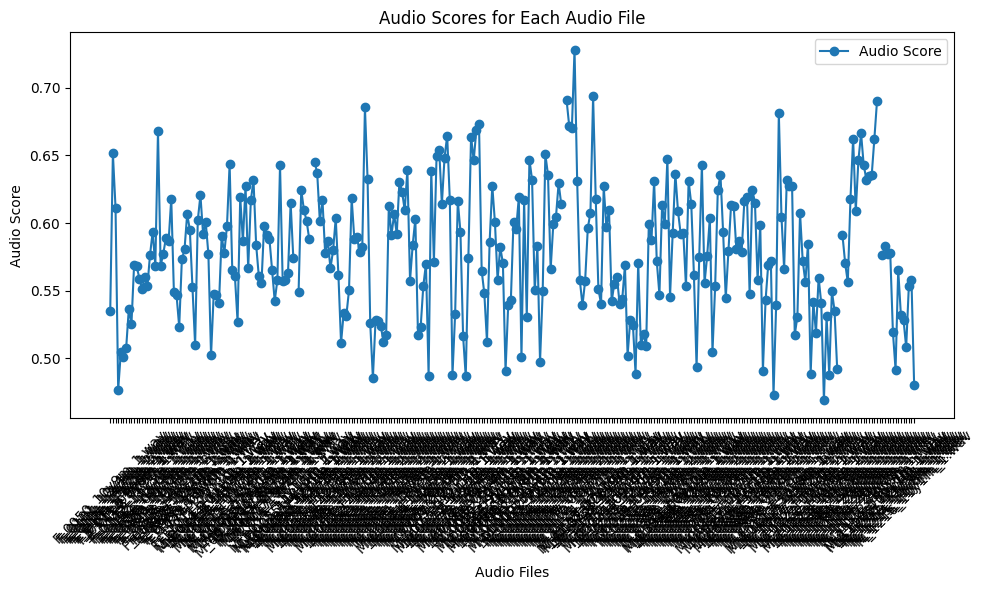

In [435]:
# Plot audio scores
plt.figure(figsize=(10, 6))
plt.title('Audio Scores for Each Audio File')
plt.xlabel('Audio Files')
plt.ylabel('Audio Score')

# Plot the audio scores
plt.plot(wav_files, audio_scores, label='Audio Score', marker='o')

# Set x-ticks to audio file names for clarity
plt.xticks(rotation=45)

# Show legend
plt.legend()

# Show plot
plt.tight_layout()
plt.show()

## Creating lists of each feaature score in all the audios

In [28]:
# Function to extract features from an audio file
def extract_features(audio_file, max_segment_duration=5):
    try:
        y, sr = librosa.load(audio_file, sr=None)
        total_duration = librosa.get_duration(y=y, sr=sr)
        num_segments = int(np.ceil(total_duration / max_segment_duration))

        pitch_values = []
        intensity_values = []
        disfluency_durations = []
        spectral_feature_scalars = []

        for i in range(num_segments):
            segment_start = i * max_segment_duration
            segment_end = min((i + 1) * max_segment_duration, total_duration)
            segment = y[int(segment_start * sr):int(segment_end * sr)]

            pitch_values.append(calculate_pitch(segment, sr))
            intensity_values.append(calculate_intensity(segment))
            disfluency_durations.append(calculate_disfluency_duration(segment, sr))
            spectral_feature_scalars.append(calculate_spectral_feature_scalar(segment, sr))

        return {
            'pitch': pitch_values,
            'intensity': intensity_values,
            'disfluency_duration': disfluency_durations,
            'spectral_feature_scalar': spectral_feature_scalars
        }

    except Exception as e:
        
        return None

def calculate_mean_pitch(audio_files, max_segment_duration=5):
    mean_pitches = []
    for audio_file in audio_files:
        try:
            features = extract_features(audio_file, max_segment_duration)
            if features:
                mean_pitches.append(np.mean(features['pitch']))
            else:
                mean_pitches.append(None)  # Append None if features is None
        except Exception as e:
            # Do nothing here if an exception occurs
            mean_pitches.append(None)  # Append None if an exception occurs
    return mean_pitches

# Function to calculate mean intensity for all audio files
def calculate_mean_intensity(audio_files, max_segment_duration=5):
    mean_intensities = []
    for audio_file in audio_files:
        try:
            features = extract_features(audio_file, max_segment_duration)
            if features:
                mean_intensities.append(np.mean(features['intensity']))
            else:
                mean_intensities.append(None)  # Append None if features is None
        except Exception as e:
            # Do nothing here if an exception occurs
            mean_intensities.append(None)  # Append None if an exception occurs
    return mean_intensities

# Function to calculate mean disfluency duration for all audio files
def calculate_mean_disfluency_duration(audio_files, max_segment_duration=5):
    mean_disfluency_durations = []
    for audio_file in audio_files:
        try:
            features = extract_features(audio_file, max_segment_duration)
            if features:
                mean_disfluency_durations.append(np.mean(features['disfluency_duration']))
            else:
                mean_disfluency_durations.append(None)  # Append None if features is None
        except Exception as e:
            # Do nothing here if an exception occurs
            mean_disfluency_durations.append(None)  # Append None if an exception occurs
    return mean_disfluency_durations

# Function to calculate mean spectral feature scalar for all audio files
def calculate_mean_spectral_feature_scalar(audio_files, max_segment_duration=5):
    mean_spectral_feature_scalars = []
    for audio_file in audio_files:
        try:
            features = extract_features(audio_file, max_segment_duration)
            if features:
                mean_spectral_feature_scalars.append(np.mean(features['spectral_feature_scalar']))
            else:
                mean_spectral_feature_scalars.append(None)  # Append None if features is None
        except Exception as e:
            # Do nothing here if an exception occurs
            mean_spectral_feature_scalars.append(None)  # Append None if an exception occurs
    return mean_spectral_feature_scalars

# List of WAV audio files

# Calculate feature scores for all audio files
mean_pitches = calculate_mean_pitch(wav_files)
mean_intensities = calculate_mean_intensity(wav_files)
mean_disfluency_durations = calculate_mean_disfluency_duration(wav_files)
mean_spectral_feature_scalars = calculate_mean_spectral_feature_scalar(wav_files)

# Print the scores
print("Mean Pitch Scores:", mean_pitches)
print("Mean Intensity Scores:", mean_intensities)
print("Mean Disfluency Duration Scores:", mean_disfluency_durations)
print("Mean Spectral Feature Scalar Scores:", mean_spectral_feature_scalars)

Mean Pitch Scores: [82.4864220033104, 33.71759667068839, 55.280681563772774, 84.54228439153208, 72.44547723858237, 80.553103092186, 79.85417728011797, 81.24738675936469, 85.57846507943708, 49.14737248381722, 57.29365558334438, 67.57577570885826, 65.88663711943259, 64.92381252456073, 68.622932797769, 58.29838130753592, 65.16247143951524, 68.03746084722346, 38.68809293040025, 72.96262002102839, 74.62725329897239, 73.87836554660996, 56.91493242646858, 47.55104272791116, 65.31160479915992, 64.82551736183858, 75.67498233476013, 57.01437104957599, 60.1127211318849, 50.78609479403588, 64.92398040870317, 63.87100531440534, 83.92602020420088, 45.683074360730636, 35.08368195056921, 64.65417364251532, 56.44113749086685, 66.27546522526937, 73.98304664230636, 56.6639776700526, 75.71205906286407, 75.35558506140227, 68.42356997137216, 68.07603102817119, 61.07955813028569, 30.864619700736174, 51.18036488970903, 62.51888359695998, 82.41510584299984, 56.999627162524426, 73.29996431825063, 44.27733055414

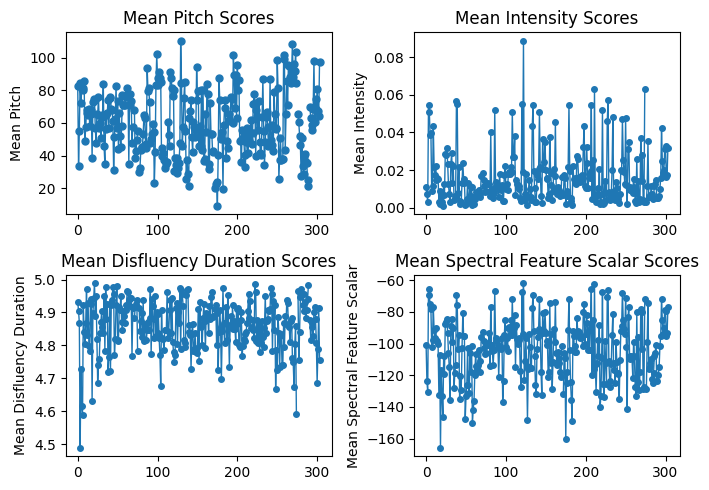

In [447]:
fig, axs = plt.subplots(2, 2, figsize=(7, 5))

# Plot mean pitch scores
axs[0, 0].plot(mean_pitches, marker='o',markersize=5, linewidth=1)
axs[0, 0].set_title('Mean Pitch Scores')
axs[0, 0].set_ylabel('Mean Pitch')

# Plot mean intensity scores
axs[0, 1].plot(mean_intensities, marker='o',markersize=4, linewidth=1)
axs[0, 1].set_title('Mean Intensity Scores')
axs[0, 1].set_ylabel('Mean Intensity')

# Plot mean disfluency duration scores
axs[1, 0].plot(mean_disfluency_durations, marker='o',markersize=4, linewidth=1)
axs[1, 0].set_title('Mean Disfluency Duration Scores')
axs[1, 0].set_ylabel('Mean Disfluency Duration')

# Plot mean spectral feature scalar scores
axs[1, 1].plot(mean_spectral_feature_scalars, marker='o',markersize=4, linewidth=1)
axs[1, 1].set_title('Mean Spectral Feature Scalar Scores')
axs[1, 1].set_ylabel('Mean Spectral Feature Scalar')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

In [29]:
print(len(mean_pitches))
print(len(mean_intensities))
print(len(mean_disfluency_durations))
print(len(mean_spectral_feature_scalars))
print("--------------------")
print(len(wav_files))

304
304
304
304
--------------------
304


In [30]:
# Plotting

In [31]:
print(len( audio_scores))

304


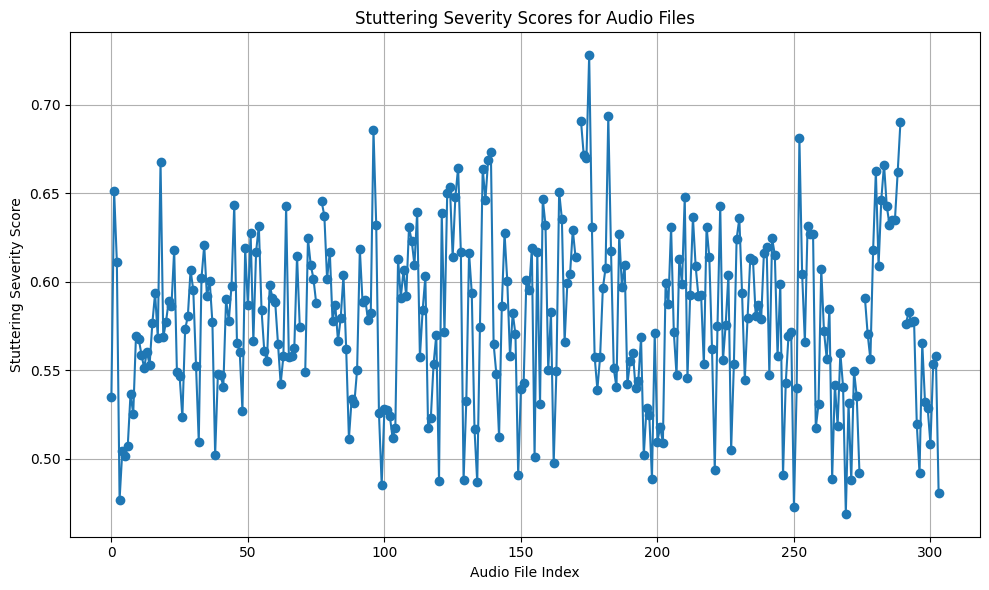

In [32]:
##plot the scores 
import matplotlib.pyplot as plt

# Assuming you have already calculated audio_scores

# Plotting the audio scores
plt.figure(figsize=(10, 6))
plt.plot(audio_scores, marker='o', linestyle='-')
plt.title('Stuttering Severity Scores for Audio Files')
plt.xlabel('Audio File Index')
plt.ylabel('Stuttering Severity Score')
plt.grid(True)
plt.tight_layout()
plt.show()



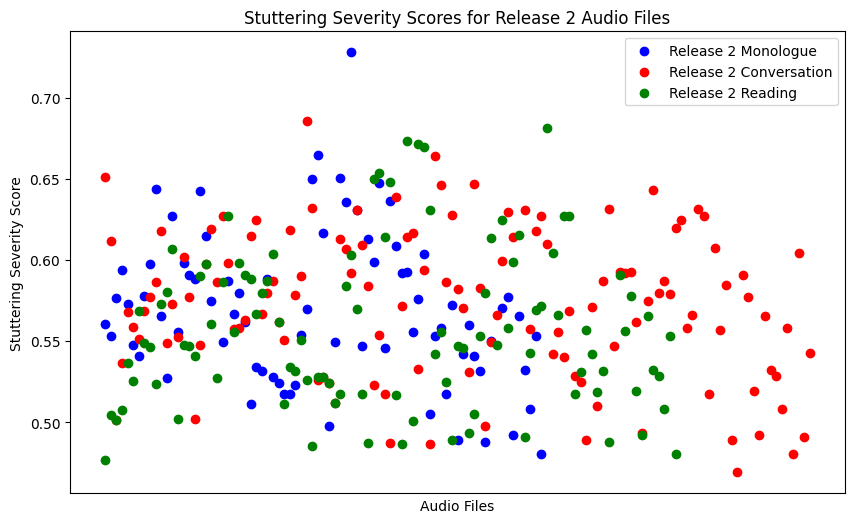

In [33]:
# Define empty lists to store scores
scores_R2_mon = []
scores_R2_con = []
scores_R2_red = []

# Plot energy levels for Release 2 Monologue audio files
plt.figure(figsize=(10, 6))
for audio_file in col1_R2_mon: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_mon.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot energy levels for Release 2 Conversation audio files
for audio_file in col1_R2_con: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_con.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot energy levels for Release 2 Reading audio files
for audio_file in col1_R2_red: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_red.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot scores as points for Release 2 Monologue
plt.scatter(range(len(scores_R2_mon)), scores_R2_mon, color='blue', marker='o', label='Release 2 Monologue')

# Plot scores as points for Release 2 Conversation
plt.scatter(range(len(scores_R2_con)), scores_R2_con, color='red', marker='o', label='Release 2 Conversation')

# Plot scores as points for Release 2 Reading
plt.scatter(range(len(scores_R2_red)), scores_R2_red, color='green', marker='o', label='Release 2 Reading')

plt.xlabel('Audio Files')
plt.ylabel('Stuttering Severity Score')
plt.title('Stuttering Severity Scores for Release 2 Audio Files')
plt.legend()  # Show legend
plt.xticks([])  # Remove x-axis ticks
plt.show()

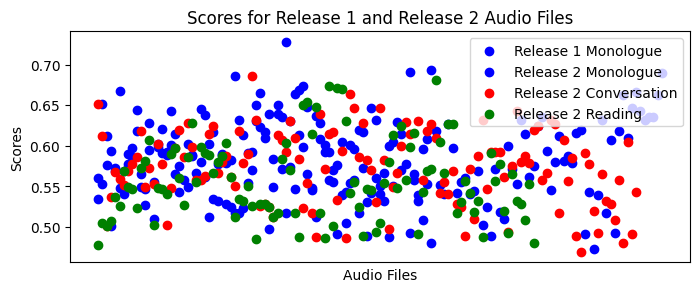

In [439]:
# Plot scores for Release 2 Monologue audio files
scores_R2_mon = []
plt.figure(figsize=(8, 3))
for audio_file in col1_R2_mon: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_mon.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot scores for Release 2 Conversation audio files
scores_R2_con = []
for audio_file in col1_R2_con: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_con.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot scores for Release 2 Reading audio files
scores_R2_red = []
for audio_file in col1_R2_red: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R2_red.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot scores for Release 1 Monologue audio files
scores_R1_mon = []
for audio_file in col1_R1_mon: 
    try:
        index = wav_files.index(audio_file + ".wav")
        scores_R1_mon.append(audio_scores[index])
    except ValueError:
        pass  # If the audio file is not found, skip it

# Plot scores as points for Release 1 Monologue
plt.scatter(range(len(scores_R1_mon)), scores_R1_mon, color='blue', marker='o', label='Release 1 Monologue')

# Plot scores as points for Release 2 Monologue
plt.scatter(range(len(scores_R2_mon)), scores_R2_mon, color='blue', marker='o', label='Release 2 Monologue')

# Plot scores as points for Release 2 Conversation
plt.scatter(range(len(scores_R2_con)), scores_R2_con, color='red', marker='o', label='Release 2 Conversation')

# Plot scores as points for Release 2 Reading
plt.scatter(range(len(scores_R2_red)), scores_R2_red, color='green', marker='o', label='Release 2 Reading')

plt.xlabel('Audio Files')
plt.ylabel('Scores')
plt.title('Scores for Release 1 and Release 2 Audio Files')
plt.legend()  # Show legend
plt.xticks([])  # Remove x-axis ticks
plt.show()

In [35]:
#Anova In orde to see if there is significant difference between the situations

In [36]:
from scipy.stats import f_oneway
import numpy as np

# Filter out None values from each group 
scores_R1_mon_filtered = [score for score in scores_R1_mon if score is not None]
scores_R2_mon_filtered = [score for score in scores_R2_mon if score is not None]
scores_R2_con_filtered = [score for score in scores_R2_con if score is not None]
scores_R2_red_filtered = [score for score in scores_R2_red if score is not None]

combined_scores_mon = scores_R1_mon_filtered + scores_R2_mon_filtered
# Perform ANOVA
f_statistic, p_value = f_oneway(combined_scores_mon, scores_R2_con_filtered, scores_R2_red_filtered)

# Print results
print("ANOVA Results:")
print("F-statistic:", f_statistic)
print("p-value:", p_value)

# Interpret results
alpha = 0.05
if p_value < alpha:
    print("Reject the null hypothesis. There are significant differences in stuttering severity scores between groups.")
else:
    print("Fail to reject the null hypothesis. There are no significant differences in stuttering severity scores between groups.")


ANOVA Results:
F-statistic: 9.049510553509641
p-value: 0.00014117783872148653
Reject the null hypothesis. There are significant differences in stuttering severity scores between groups.


### post-hoc

In [37]:
!pip install statsmodels


[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [38]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import numpy as np

# Perform Tukey's HSD post hoc test 
if p_value < alpha:
    data = np.concatenate([scores_R2_mon_filtered, scores_R2_con_filtered, scores_R2_red_filtered])
    # Remove the 'R2_' prefix from the labels
    labels = ['mon'] * len(scores_R2_mon_filtered) + ['con'] * len(scores_R2_con_filtered) + ['red'] * len(scores_R2_red_filtered)
    tukey_results = pairwise_tukeyhsd(data, labels, alpha=0.05)

    # Print Tukey's HSD results
    print("\nTukey's HSD Results:")
    print(tukey_results)


Tukey's HSD Results:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
   con    mon  -0.0036 0.8544 -0.0195  0.0123  False
   con    red  -0.0153 0.0372   -0.03 -0.0007   True
   mon    red  -0.0117 0.2191 -0.0283  0.0048  False
----------------------------------------------------


In [39]:
# Machine learning

In [40]:
# Before starting with the models in machine learning we have to: 
#1 orginize the data(all the files in one file)
#2 use methods to deal with the small number of observations that we have

In [485]:
#Orginizing the data 

# Add the name of situation to each DataFrame
R1_mon['situation'] = 'monologue'
R2_mon['situation'] = 'monologue'
R2_con['situation'] = 'conversation'
R2_Read['situation'] = 'reading'

# Create a dictionary to map filenames (without .wav) to their scores
file_scores = {filename[:-4]: score for filename, score in zip(wav_files, audio_scores)}

# Function to get the score for a filename (without .wav), returns None if filename not found
def get_score(filename):
    return file_scores.get(filename)

# Adding the audio scores that are relevant to each file
R1_mon["audio_score"] = [get_score(x) for x in col1_R1_mon]
R2_mon["audio_score"] = [get_score(x) for x in col1_R2_mon]
R2_con["audio_score"] = [get_score(x) for x in col1_R2_con]
R2_Read["audio_score"] = [get_score(x) for x in col1_R2_red]  



In [486]:

# Print column names of each DataFrame

print(R1_mon.columns.tolist()) 
print(R2_mon.columns.tolist())
print(R2_con.columns.tolist()) 
print(R2_Read.columns.tolist())
print(R1_mon)


['File name ', 'Gender', 'Handedness', 'Family History', 'Age of onset', 'Age at recording', 'Where recorded', 'Recording conditions', 'Type of therapy', 'Time between therapy and recording', 'Hearing problems', 'Language problems', 'SEN', 'Orthographic', 'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise', 'Speaker Quality', 'Interruptions', 'situation', 'audio_score']
['File name', 'Gender', 'Handedness', 'Family History', 'Age at onset', 'Age at recording', 'Where recorded', 'Recording conditions', 'Word count', 'Type of therapy', 'Time between therapy and recording', 'Hearing problems', 'Language problems', 'PHL', 'SEN', 'Orthographic', 'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise', 'Speaker Quality', 'Interruptions', 'situation', 'audio_score']
['File name', 'Gender', 'Handedness', 'Family History', 'Age at onset', 'Age at recording', 'Where recorded', 'Recording conditions', 'Type of therapy', 'Time between therapy and recording', 'Hearing problems', 'Language problems'

## for the new lists

In [487]:
# Create dictionaries for each feature
pitch_scores_dict = {}
intensity_scores_dict = {}
disfluency_duration_dict = {}
spectral_feature_scalar_dict = {}

# Populate dictionaries with scores for each observation
for filename, score in zip(wav_files, mean_pitches):
    filename_key = filename[:-4]  # Removing the .wav extension
    pitch_scores_dict[filename_key] = score

for filename, score in zip(wav_files, mean_intensities):
    filename_key = filename[:-4]  # Removing the .wav extension
    intensity_scores_dict[filename_key] = score

for filename, score in zip(wav_files, mean_disfluency_durations):
    filename_key = filename[:-4]  # Removing the .wav extension
    disfluency_duration_dict[filename_key] = score

for filename, score in zip(wav_files, mean_spectral_feature_scalars):
    filename_key = filename[:-4]  # Removing the .wav extension
    spectral_feature_scalar_dict[filename_key] = score
# Define functions to get scores for each feature
def get_pitch_score(filename):
    return pitch_scores_dict.get(filename)

def get_intensity_score(filename):
    return intensity_scores_dict.get(filename)

def get_disfluency_duration(filename):
    return disfluency_duration_dict.get(filename)

def get_spectral_feature_scalar(filename):
    return spectral_feature_scalar_dict.get(filename)

# Add scores for each feature to DataFrames
R1_mon["pitch_score"] = [get_pitch_score(x) for x in col1_R1_mon]
R1_mon["intensity_score"] = [get_intensity_score(x) for x in col1_R1_mon]
R1_mon["disfluency_duration"] = [get_disfluency_duration(x) for x in col1_R1_mon]
R1_mon["spectral_feature_scalar"] = [get_spectral_feature_scalar(x) for x in col1_R1_mon]

R2_mon["pitch_score"] = [get_pitch_score(x) for x in col1_R2_mon]
R2_mon["intensity_score"] = [get_intensity_score(x) for x in col1_R2_mon]
R2_mon["disfluency_duration"] = [get_disfluency_duration(x) for x in col1_R2_mon]
R2_mon["spectral_feature_scalar"] = [get_spectral_feature_scalar(x) for x in col1_R2_mon]

R2_con["pitch_score"] = [get_pitch_score(x) for x in col1_R2_con]
R2_con["intensity_score"] = [get_intensity_score(x) for x in col1_R2_con]
R2_con["disfluency_duration"] = [get_disfluency_duration(x) for x in col1_R2_con]
R2_con["spectral_feature_scalar"] = [get_spectral_feature_scalar(x) for x in col1_R2_con]

R2_Read["pitch_score"] = [get_pitch_score(x) for x in col1_R2_red]
R2_Read["intensity_score"] = [get_intensity_score(x) for x in col1_R2_red]
R2_Read["disfluency_duration"] = [get_disfluency_duration(x) for x in col1_R2_red]
R2_Read["spectral_feature_scalar"] = [get_spectral_feature_scalar(x) for x in col1_R2_red]

In [488]:
# Print the columns of each DataFrame to see if the new variables are added
print("Columns of R1_mon:", R1_mon.columns)
print("Columns of R2_mon:", R2_mon.columns)
print("Columns of R2_con:", R2_con.columns)
print("Columns of R2_Read:", R2_Read.columns)


Columns of R1_mon: Index(['File name ', 'Gender', 'Handedness', 'Family History', 'Age of onset',
       'Age at recording', 'Where recorded', 'Recording conditions',
       'Type of therapy', 'Time between therapy and recording',
       'Hearing problems', 'Language problems', 'SEN', 'Orthographic',
       'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise',
       'Speaker Quality', 'Interruptions', 'situation', 'audio_score',
       'pitch_score', 'intensity_score', 'disfluency_duration',
       'spectral_feature_scalar'],
      dtype='object')
Columns of R2_mon: Index(['File name', 'Gender', 'Handedness', 'Family History', 'Age at onset',
       'Age at recording', 'Where recorded', 'Recording conditions',
       'Word count', 'Type of therapy', 'Time between therapy and recording',
       'Hearing problems', 'Language problems', 'PHL', 'SEN', 'Orthographic',
       'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise',
       'Speaker Quality', 'Interruptions', 'situation', 'aud

In [489]:
def format_words(words):
    formatted_words = []
    for word in words:
        # Convert to lowercase, remove leading and trailing spaces, and replace inner spaces with underscores
        formatted_word = word.strip().lower().replace(" ", "_")
        formatted_words.append(formatted_word)
    return formatted_words


In [490]:

# Now, all DataFrames should have consistent column names  

col_new_R1_mon = format_words(R1_mon) 
col_new_R1_mon = ["age_at_onset" if x == "age_of_onset" else x for x in col_new_R1_mon]  #chaning age_of_onset to age_at_onset (: 

col_new_R2_mon = format_words(R2_mon)
col_new_R2_con = format_words(R2_con)
col_new_R2_Read = format_words(R2_Read)

In [491]:
#Past columns names 
print(R1_mon.columns.tolist()) 
print(R2_mon.columns.tolist())
print(R2_con.columns.tolist()) 
print(R2_Read.columns.tolist())

['File name ', 'Gender', 'Handedness', 'Family History', 'Age of onset', 'Age at recording', 'Where recorded', 'Recording conditions', 'Type of therapy', 'Time between therapy and recording', 'Hearing problems', 'Language problems', 'SEN', 'Orthographic', 'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise', 'Speaker Quality', 'Interruptions', 'situation', 'audio_score', 'pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
['File name', 'Gender', 'Handedness', 'Family History', 'Age at onset', 'Age at recording', 'Where recorded', 'Recording conditions', 'Word count', 'Type of therapy', 'Time between therapy and recording', 'Hearing problems', 'Language problems', 'PHL', 'SEN', 'Orthographic', 'Phonetic', 'Time aligned', 'Tape Noise', 'Env Noise', 'Speaker Quality', 'Interruptions', 'situation', 'audio_score', 'pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
['File name', 'Gender', 'Handedness', 'Family History', 'Age a

In [492]:
#New columns names
print(col_new_R1_mon)
print(col_new_R2_mon)
print(col_new_R2_con)
print(col_new_R2_Read)

['file_name', 'gender', 'handedness', 'family_history', 'age_at_onset', 'age_at_recording', 'where_recorded', 'recording_conditions', 'type_of_therapy', 'time_between_therapy_and_recording', 'hearing_problems', 'language_problems', 'sen', 'orthographic', 'phonetic', 'time_aligned', 'tape_noise', 'env_noise', 'speaker_quality', 'interruptions', 'situation', 'audio_score', 'pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
['file_name', 'gender', 'handedness', 'family_history', 'age_at_onset', 'age_at_recording', 'where_recorded', 'recording_conditions', 'word_count', 'type_of_therapy', 'time_between_therapy_and_recording', 'hearing_problems', 'language_problems', 'phl', 'sen', 'orthographic', 'phonetic', 'time_aligned', 'tape_noise', 'env_noise', 'speaker_quality', 'interruptions', 'situation', 'audio_score', 'pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
['file_name', 'gender', 'handedness', 'family_history', 'age_at

In [493]:
R1_mon.columns= col_new_R1_mon
R2_mon.columns= col_new_R2_mon
R2_con.columns= col_new_R2_con
R2_Read.columns= col_new_R2_Read


In [494]:
#Final data

In [495]:
# Combine the DataFrames row-wise
final_data = pd.concat([R1_mon, R2_mon, R2_con, R2_Read], ignore_index=True)

# Print the head of the final DataFrame to verify the result
print(final_data.head())

        file_name gender handedness family_history age_at_onset  \
0  F_0050_10y9m_1      F      right             no           36   
1  F_0101_10y4m_1      F       left             no           78   
2  F_0101_13y1m_1      F       left             no           78   
3  F_0101_15y2m_1      F       left             no           78   
4  F_0111_09y6m_1      F  not known      not known    not known   

   age_at_recording where_recorded recording_conditions type_of_therapy  \
0               129         Clinic                   QR               F   
1               124         Clinic                   QR               F   
2               157            UCL                   QR               F   
3               182            UCL                   QR               F   
4               114         Clinic                   QR               F   

   time_between_therapy_and_recording  ...  interruptions  situation  \
0                                  11  ...            1.0  monologue   
1 

In [496]:
#Machine learning

In [497]:

final_data_reset= final_data # we use it to reset (instead of running the first code again)

all_var= final_data.columns.tolist()
print(all_var) 


['file_name', 'gender', 'handedness', 'family_history', 'age_at_onset', 'age_at_recording', 'where_recorded', 'recording_conditions', 'type_of_therapy', 'time_between_therapy_and_recording', 'hearing_problems', 'language_problems', 'sen', 'orthographic', 'phonetic', 'time_aligned', 'tape_noise', 'env_noise', 'speaker_quality', 'interruptions', 'situation', 'audio_score', 'pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar', 'word_count', 'phl', 'content']


In [498]:
print(final_data['gender'].unique())
print(final_data["situation"].unique()) 
print(final_data['handedness'].unique())
print(final_data['family_history'].unique())
print(final_data['where_recorded'].unique())
print(final_data['recording_conditions'].unique())
print(final_data['hearing_problems'].unique())
print(final_data['language_problems'].unique())


['F' 'M' 'Female' 'Male']
['monologue' 'conversation' 'reading']
['right' 'left' 'not known']
['no' 'not known' 'yes']
['Clinic' 'UCL' 'Home']
['QR' 'STR']
[False  True]
[False  True]


In [499]:
# Ensure no leading/trailing spaces
final_data['gender'] = final_data['gender'].str.strip()

# Ensure consistent data types
final_data['gender'] = final_data['gender'].astype(str)

# Replace 'F' with 'Female' and 'M' with 'Male'
final_data['gender'] = final_data['gender'].replace({'F': 'Female', 'M': 'Male'})

# Check unique values to confirm the change
print(final_data['gender'].unique())

['Female' 'Male']


In [500]:
# Ensure no leading/trailing spaces
final_data['type_of_therapy'] = final_data['type_of_therapy'].str.strip()

# Ensure consistent data types
final_data['type_of_therapy'] = final_data['type_of_therapy'].astype(str)

# Replace values in the 'type_of_therapy' column
final_data['type_of_therapy'] = final_data['type_of_therapy'].replace({'F': 'Family', 'H': 'Holistic'})

# Check unique values to confirm the change
print(final_data['type_of_therapy'].unique())

['Family' 'Holistic']


In [501]:
print(final_data['family_history'].unique())

['no' 'not known' 'yes']


In [502]:
#Model selection 

#number of all the observations 
num_observations = len(final_data)
print("Number of all observations:", num_observations)


# Counting NA in each variable
na_counts = final_data.isna().sum()
print("\nNA counts in each variable:")
print(na_counts) #missing values in each variable


Number of all observations: 455

NA counts in each variable:
file_name                               0
gender                                  0
handedness                              0
family_history                          0
age_at_onset                            0
age_at_recording                        0
where_recorded                          0
recording_conditions                    0
type_of_therapy                         0
time_between_therapy_and_recording      0
hearing_problems                        0
language_problems                       0
sen                                     0
orthographic                            0
phonetic                                0
time_aligned                            0
tape_noise                              0
env_noise                               0
speaker_quality                         0
interruptions                           0
situation                               0
audio_score                            19
pitch_score    

.....

The 'not known' values in the family history and handedness is concidered categorical values because they mentiones in the article that it takes 3 values , So i will reconvert them to 'not known' and convert the variable to categorical . 
and for age on onset , since it numerical, i will fill the 'unknown' values with the mean (Imputation). 

.....

In [510]:
###fill na with unknown in the handedness and family history 
import pandas as pd

# Fill NaN values with 'unknown' in the 'handedness' column
final_data['handedness'] = final_data['handedness'].fillna('not known')

# Fill NaN values with 'unknown' in the 'family_history' column
final_data['family_history'] = final_data['family_history'].fillna('not known')

# Check unique values in the 'family_history' column
print(final_data['family_history'].unique())

#######


###Imputation for 'age_at_onset ' :  
# Convert 'not known' to NaN in the 'age_at_onset' column
final_data['age_at_onset'] = final_data['age_at_onset'].replace('not known', pd.NA)

# Convert the column to numeric type
final_data['age_at_onset'] = pd.to_numeric(final_data['age_at_onset'])

# Fill NaN values with mean in the 'age_at_onset' column
mean_value = final_data['age_at_onset'].mean()
final_data['age_at_onset'] = final_data['age_at_onset'].fillna(mean_value)

# Check unique values in the 'age_at_onset' column
print(final_data['age_at_onset'].unique())




#######
# Counting NA in each variable
na_counts = final_data.isna().sum()
print("\nNA counts in each variable:")
print(na_counts) #missing values in each variable

['no' 'not known' 'yes']
[36.         78.         56.92121212 60.         48.         72.
 96.         42.         45.         54.         30.         50.
 90.         84.         18.         66.         24.        ]

NA counts in each variable:
file_name                               0
gender                                  0
handedness                              0
family_history                          0
age_at_onset                            0
age_at_recording                        0
where_recorded                          0
recording_conditions                    0
type_of_therapy                         0
time_between_therapy_and_recording      0
hearing_problems                        0
language_problems                       0
sen                                     0
orthographic                            0
phonetic                                0
time_aligned                            0
tape_noise                              0
env_noise                               

In [511]:
#print all the categories in order to do mapping when converting to factors
print(final_data['family_history'].unique())  
print(final_data['handedness'].unique()) 
print(final_data['gender'].unique())
print(final_data['where_recorded'].unique())
print(final_data[ 'recording_conditions'].unique())
print(final_data['type_of_therapy'].unique())
print(final_data[ 'hearing_problems'].unique())
print(final_data['language_problems'].unique())  
print(final_data['sen'].unique()) 
print(final_data[ 'orthographic'].unique()) 
print(final_data['phonetic'].unique()) 
print(final_data['time_aligned'].unique()) 
print(final_data[ 'situation' ].unique()) 
print(final_data[ 'phl'].unique()) 


                  


['no' 'not known' 'yes']
['right' 'left' 'not known']
['Female' 'Male']
['Clinic' 'UCL' 'Home']
['QR' 'STR']
['Family' 'Holistic']
[False  True]
[False  True]
[False  True]
[False  True]
[False  True]
[False  True]
['monologue' 'conversation' 'reading']
[nan 'English' 'Arabic' 'Somali' 'Tamil' 'Yoruba' 'Punjabi' 'Italian'
 'French' 'Turkish' 'Urdu']


In [512]:
# deleting the variables that include high rate of missing values 
#We put 0.4 missing of the observations as high rate because we don't have a lot of observations

threshold = 0.4  # Example threshold, adjust as needed
variables_to_keep = na_counts[na_counts / num_observations <= threshold].index
variables_to_delete = na_counts[na_counts / num_observations > threshold].index
final_data_filtered = final_data[variables_to_keep].copy()

print("\nVariables after filtering:")
print(final_data_filtered.head())

print("\nVariables deleted due to having too many missing values:")
print(variables_to_delete)






Variables after filtering:
        file_name  gender handedness family_history  age_at_onset  \
0  F_0050_10y9m_1  Female      right             no     36.000000   
1  F_0101_10y4m_1  Female       left             no     78.000000   
2  F_0101_13y1m_1  Female       left             no     78.000000   
3  F_0101_15y2m_1  Female       left             no     78.000000   
4  F_0111_09y6m_1  Female  not known      not known     56.921212   

   age_at_recording where_recorded recording_conditions type_of_therapy  \
0               129         Clinic                   QR          Family   
1               124         Clinic                   QR          Family   
2               157            UCL                   QR          Family   
3               182            UCL                   QR          Family   
4               114         Clinic                   QR          Family   

   time_between_therapy_and_recording  ...  env_noise  speaker_quality  \
0                               

In [513]:
# Deleting observations with NA
final_data_filtered= final_data_filtered.dropna() 
print(final_data_filtered)

           file_name  gender handedness family_history  age_at_onset  \
138   F_0142_11y3m_1  Female      right             no     36.000000   
139   F_0142_11y5m_1  Female      right             no     36.000000   
140   F_0142_11y7m_1  Female      right             no     36.000000   
141   F_0142_12y0m_1  Female      right             no     36.000000   
142  F_0818_15y11m_1  Female      right             no     60.000000   
..               ...     ...        ...            ...           ...   
450   M_1212_11y3m_1    Male      right            yes     66.000000   
451   M_1213_11y3m_1    Male      right      not known     60.000000   
452   M_1214_11y8m_1    Male      right            yes     56.921212   
453   M_1215_11y0m_1    Male      right      not known     56.921212   
454   M_1216_11y1m_1    Male      right            yes     84.000000   

     age_at_recording where_recorded recording_conditions type_of_therapy  \
138               135         Clinic                   QR 

In [514]:
num_rows, num_cols = final_data_filtered.shape

print("Number of rows:", num_rows)
print("Number of columns:", num_cols)

Number of rows: 305
Number of columns: 27


In [515]:
# Count missing values in each variable
missing_counts = final_data_filtered.isna().sum()

# Print the missing value counts
print("Missing value counts for each variable:")
print(missing_counts)

Missing value counts for each variable:
file_name                             0
gender                                0
handedness                            0
family_history                        0
age_at_onset                          0
age_at_recording                      0
where_recorded                        0
recording_conditions                  0
type_of_therapy                       0
time_between_therapy_and_recording    0
hearing_problems                      0
language_problems                     0
sen                                   0
orthographic                          0
phonetic                              0
time_aligned                          0
tape_noise                            0
env_noise                             0
speaker_quality                       0
interruptions                         0
situation                             0
audio_score                           0
pitch_score                           0
intensity_score                       0


In [516]:
##convert categorical variables to factor: 
#Converting categorical variables to factor 

# List of columns to convert to factors
cols_to_factorize = ['gender', 'handedness', 'family_history', 'where_recorded',
                     'recording_conditions', 'type_of_therapy', 'hearing_problems',
                     'language_problems', 'sen', 'orthographic', 'phonetic', 
                     'time_aligned',  
                     'situation' , 'phl']

# Convert selected columns to factors
final_data_filtered[cols_to_factorize] = final_data[cols_to_factorize].apply(lambda x: pd.factorize(x)[0])

print(final_data_filtered["situation"].unique())


[0 1 2]


In [517]:
# Reset index
final_data_filtered.reset_index(inplace=True)

# Drop 'file_name' and 'index' columns if they exist
if 'file_name' in final_data_filtered.columns:
    final_data_filtered.drop(columns='file_name', inplace=True)
if 'index' in final_data_filtered.columns:
    final_data_filtered.drop(columns='index', inplace=True) 
    # Drop 'level_0' column
if 'level_0' in final_data_filtered.columns:
    final_data_filtered.drop(columns='level_0', inplace=True)


In [518]:
num_rows, num_cols = final_data_filtered.shape

print("Number of rows:", num_rows)
print("Number of columns:", num_cols)

Number of rows: 305
Number of columns: 26


## Way 1

### For models we shpuld work on standarized data
### For clustering we used the original data

In [277]:
print(final_data_filtered["situation"].unique())

[0 1 2]


In [338]:
#Standardizing the data

final_data_filtered_stan = final_data_filtered.copy()
# Categorical columns as specified
categorical_columns = [
    'gender', 'handedness', 'family_history', 'where_recorded',
    'recording_conditions', 'type_of_therapy', 'hearing_problems',
    'language_problems', 'sen', 'orthographic', 'phonetic', 
    'time_aligned', 'situation', 'phl'
]

# Identify numeric columns by excluding the categorical columns
numeric_columns = final_data_filtered_stan.columns.difference(categorical_columns).tolist()

# Standardize the numeric columns
scaler = StandardScaler()
final_data_filtered_stan[numeric_columns] = scaler.fit_transform(final_data_filtered_stan[numeric_columns])

# Combine the standardized numeric columns with the categorical columns
final_data_filtered_stan = pd.concat([final_data_filtered_stan[categorical_columns], final_data_filtered_stan[numeric_columns]], axis=1)

print(final_data_filtered_stan)


     gender  handedness  family_history  where_recorded  recording_conditions  \
0         0           0               0               0                     0   
1         0           0               0               0                     0   
2         0           0               0               0                     0   
3         0           0               0               0                     0   
4         0           0               0               1                     0   
..      ...         ...             ...             ...                   ...   
300       1           0               2               0                     0   
301       1           0               1               0                     0   
302       1           0               2               0                     0   
303       1           0               1               0                     0   
304       1           0               2               0                     0   

     type_of_therapy  heari

In [339]:
#Dividing the data into train and test

from sklearn.model_selection import train_test_split

# Extract features and labels
X = final_data_filtered_stan.drop(columns=['situation'])  # Features
y = final_data_filtered_stan['situation']  # Labels

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


## SVM without cross validation

In [340]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, mean_squared_error

# Train SVM classifier
svm_classifier = SVC(kernel='linear') 
svm_classifier.fit(X_train, y_train)

# Predictions
y_pred = svm_classifier.predict(X_test)

# Calculate accuracy
accuracy_SVM_way1 = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy_SVM_way1)

# Calculate mean squared error (MSE)
mse_SVM_way1 = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse_SVM_way1)

Accuracy: 0.532608695652174
Mean Squared Error (MSE): 0.9891304347826086


### Confusion matrix

In [341]:
!pip install seaborn


[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [342]:
from sklearn.metrics import confusion_matrix
#general function that We will use to the other methods
def plot_confusion_matrix(y_true, y_pred, classes, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title(title)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)
    plt.xlabel('Predicted label')
    plt.ylabel('True label')

    # Add text annotations for each cell
    for i in range(len(classes)):
        for j in range(len(classes)):
            plt.text(j, i, format(cm[i, j], 'd'),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > cm.max() / 2 else "black")

    plt.colorbar()
    plt.show()


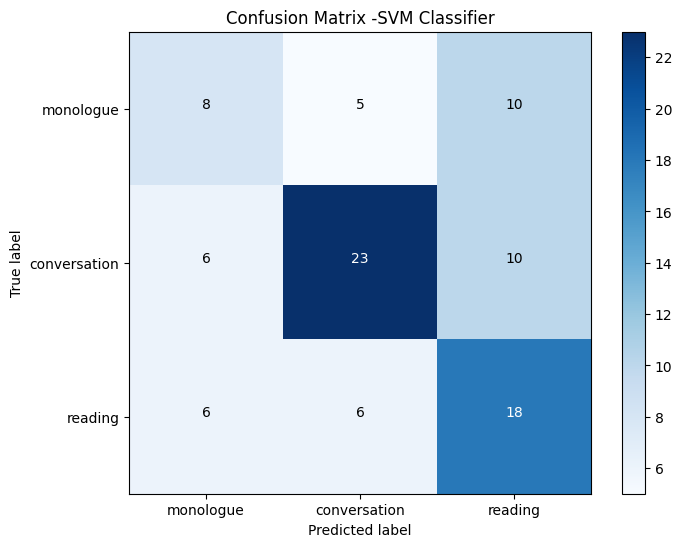

In [343]:
custom_classes = ['monologue', 'conversation', 'reading']
plot_confusion_matrix(y_test, y_pred, custom_classes, 'Confusion Matrix -SVM Classifier')


## SVM with cross validation

In [344]:
# we got bad results this may improve by using cross validation(because we have only 314 observations ) - we used 5 folds
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC

svm_classifier = SVC(kernel='linear')

# 5 folds
cv_scores = cross_val_score(svm_classifier, X, y, cv=5)

# the scores of cross-validation: 
print("Cross-Validation Scores:", cv_scores)

#  mean and standard deviation of cross-validation scores
mean_cv_score = cv_scores.mean()
std_cv_score = cv_scores.std()
print("Mean Cross-Validation Score:", mean_cv_score)
print("Standard Deviation of Cross-Validation Scores:", std_cv_score)
# : 


Cross-Validation Scores: [0.67213115 0.45901639 0.54098361 0.55737705 0.52459016]
Mean Cross-Validation Score: 0.5508196721311476
Standard Deviation of Cross-Validation Scores: 0.06924167895718975


## Random forest classifier

In [345]:

##Random Forest Classifier : 
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
# Train Random Forest Classifier
rf_classifier.fit(X_train, y_train)

# Predictions
y_pred_rf = rf_classifier.predict(X_test)

# check  accuracy
accuracy_rf_way1 = accuracy_score(y_test, y_pred_rf)
print("Random Forest Accuracy:", accuracy_rf_way1)

# Check MSE 
mse_rf_way1 = mean_squared_error(y_test, y_pred_rf)
print("Random Forest Mean Squared Error (MSE):", mse_rf_way1)



Random Forest Accuracy: 0.3804347826086957
Random Forest Mean Squared Error (MSE): 1.2717391304347827


### Confusion matrix

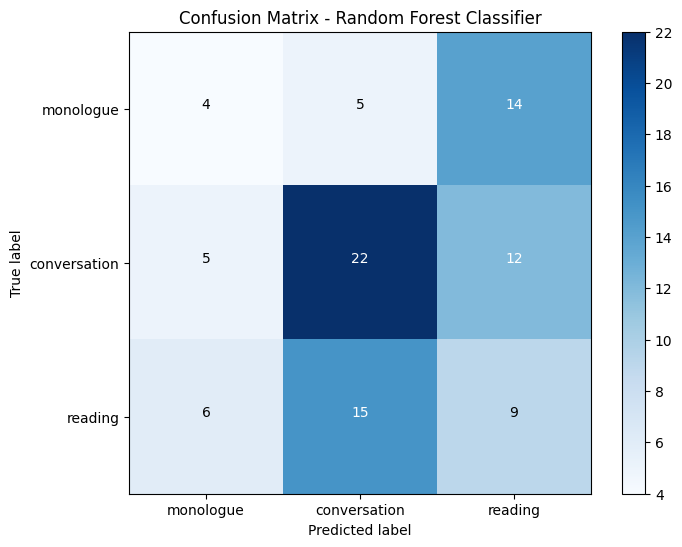

In [346]:
# Plot confusion matrix for Random Forest Classifier
plot_confusion_matrix(y_test, y_pred_rf, custom_classes, 'Confusion Matrix - Random Forest Classifier')


## k-Nearest Neighbors Classifier 

In [347]:
## k-Nearest Neighbors Classifier 

from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, mean_squared_error

# Train k-NN classifier
knn_classifier = KNeighborsClassifier(n_neighbors=5)
knn_classifier.fit(X_train, y_train)

# Predictions
y_pred_knn = knn_classifier.predict(X_test)

# Calculate accuracy
accuracy_knn_way1 = accuracy_score(y_test, y_pred_knn)
print("k-NN Classifier Accuracy:", accuracy_knn_way1)

# Calculate mean squared error (MSE)
mse_knn_way1 = mean_squared_error(y_test, y_pred_knn)
print("k-NN Classifier Mean Squared Error (MSE):", mse_knn_way1)



k-NN Classifier Accuracy: 0.43478260869565216
k-NN Classifier Mean Squared Error (MSE): 1.1521739130434783


### Confusion matrix

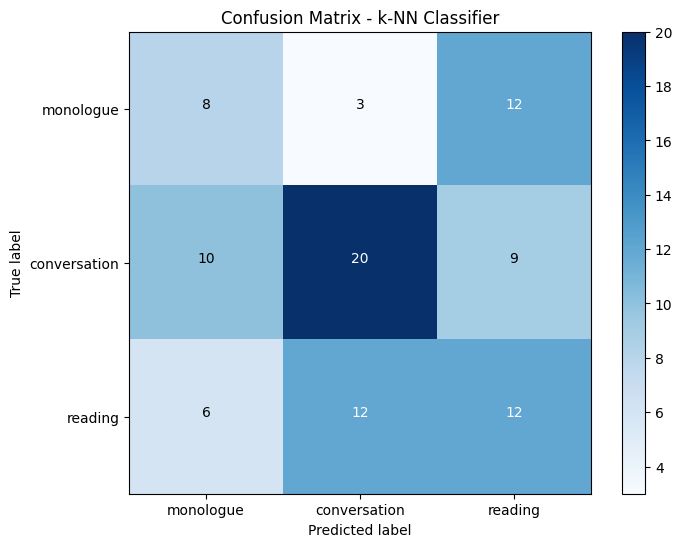

In [348]:
plot_confusion_matrix(y_test, y_pred_knn, custom_classes, 'Confusion Matrix - k-NN Classifier')

## Logistic Regression Classifier

In [349]:
#Logistic Regression Classifier

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, mean_squared_error

# Train logistic regression classifier with adjusted solver and increased max_iter
logistic_classifier = LogisticRegression(multi_class='multinomial', solver='saga', max_iter=2000)
logistic_classifier.fit(X_train, y_train)

# Predictions
y_pred_logistic = logistic_classifier.predict(X_test)

# Calculate accuracy
accuracy_logistic_way1 = accuracy_score(y_test, y_pred_logistic)
print("Logistic Regression Classifier Accuracy:", accuracy_logistic_way1)

# Calculate mean squared error (MSE)
mse_logistic_way1 = mean_squared_error(y_test, y_pred_logistic)
print("Logistic Regression Classifier Mean Squared Error (MSE):", mse_logistic_way1)

Logistic Regression Classifier Accuracy: 0.5652173913043478
Logistic Regression Classifier Mean Squared Error (MSE): 0.9239130434782609


### Confusion matrix

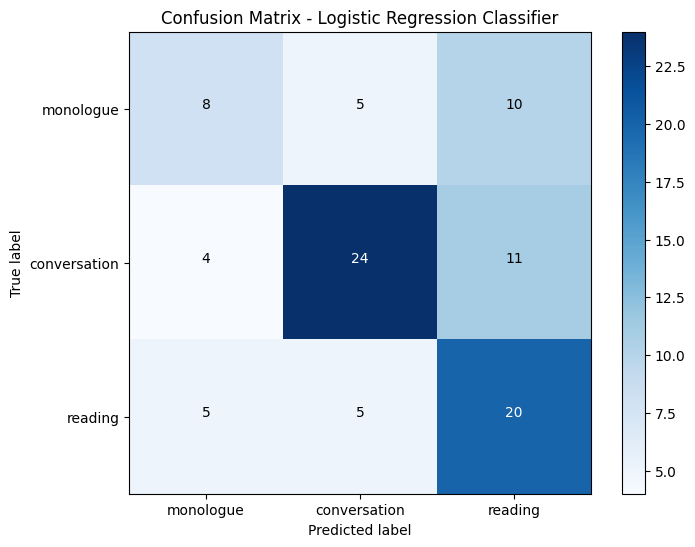

In [350]:
plot_confusion_matrix(y_test, y_pred_logistic, custom_classes, 'Confusion Matrix - Logistic Regression Classifier')

# part 2

In [355]:
#['monologue' 'conversation' 'reading']
#[0,1,2]

print(final_data['situation'].unique())
print(final_data_filtered['situation'].unique())

['monologue' 'conversation' 'reading']
[0 1 2]


In [356]:
# Changing the situation variable to have 2 categories
# Combining "Reading, Monologue" in the same category and conversation in the other
final_data_filtered_way2 = final_data_filtered.copy()

# Map 'monologue' and 'reading' to 0, and 'conversation' to 1
final_data_filtered_way2['situation'] = final_data_filtered_way2['situation'].replace({0: 0, 1: 1, 2: 0})

# Confirm the changes
print(final_data_filtered_way2['situation'].unique())

# To check that final_data_filtered is unchanged
print(final_data_filtered['situation'].unique())




[0 1]
[0 1 2]


In [357]:
#Work on the standarized data
final_data_filtered_way2_stan = final_data_filtered_stan.copy()

# Map 'monologue' and 'reading' to 0, and 'conversation' to 1
final_data_filtered_way2_stan['situation'] = final_data_filtered_way2_stan['situation'].replace({0: 0, 1: 1, 2: 0})

# Confirm the changes
print(final_data_filtered_way2_stan['situation'].unique())

# To check that final_data_filtered is unchanged
print(final_data_filtered_stan['situation'].unique())



[0 1]
[0 1 2]


In [358]:
#Dividing the data into train and test

from sklearn.model_selection import train_test_split

# Extract features and labels
X = final_data_filtered_way2_stan.drop(columns=['situation'])  # Features
y = final_data_filtered_way2_stan['situation']  # Labels

X_train_way2, X_test_way2, y_train_way2, y_test_way2 = train_test_split(X, y, test_size=0.3, random_state=42)


## SVM without cross validation

In [359]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, mean_squared_error

# Train SVM classifier
svm_classifier = SVC(kernel='linear')  # You can try different kernels like 'rbf' or 'poly'
svm_classifier.fit(X_train_way2, y_train_way2)

# Predictions
y_pred_way2 = svm_classifier.predict(X_test_way2)

# Calculate accuracy
accuracy_SVM_way2 = accuracy_score(y_test_way2, y_pred_way2)
print("Accuracy:", accuracy_SVM_way2 )

# Calculate mean squared error (MSE)
mse_SVM_way2 = mean_squared_error(y_test_way2, y_pred_way2)
print("Mean Squared Error (MSE):", mse_SVM_way2 )

Accuracy: 0.75
Mean Squared Error (MSE): 0.25


### Confusion matrix

In [360]:
from sklearn.metrics import confusion_matrix
# Function to plot simplified confusion matrix for binary classification with custom class labels
def plot_binary_confusion_matrix(y_true, y_pred, classes, title):
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm[0, 0], cm[0, 1], cm[1, 0], cm[1, 1]  # Extract values from confusion matrix
    
    plt.figure(figsize=(6, 6))  # Adjust the figure size here
    plt.imshow([[tp, fp], [fn, tn]], interpolation='nearest', cmap=plt.cm.Blues)
    plt.title(title)
    tick_marks = np.arange(2)
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)
    plt.xlabel('Predicted label')
    plt.ylabel('True label')

    # Add text annotations for each cell
    plt.text(0, 0, tp, horizontalalignment="center", color="white")
    plt.text(1, 0, fp, horizontalalignment="center", color="black")
    plt.text(0, 1, fn, horizontalalignment="center", color="black")
    plt.text(1, 1, tn, horizontalalignment="center", color="white")

    plt.colorbar()
    plt.show()


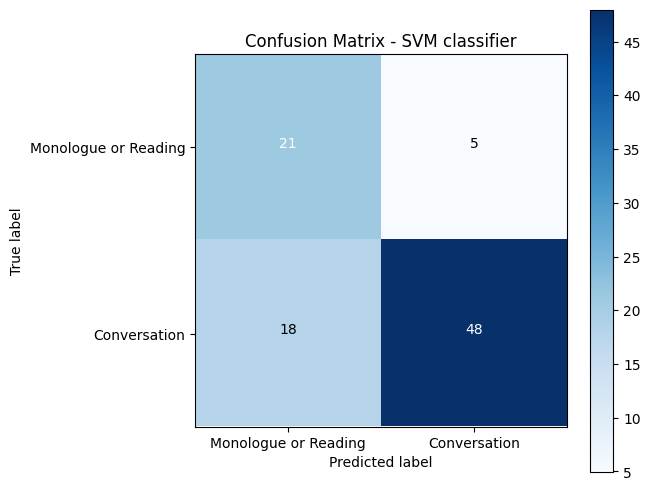

In [361]:
custom_classes_combined = ['Monologue or Reading', 'Conversation']

# Replace y_pred_way2 with the predicted labels obtained from the classifier trained on the combined dataset (way2)
# Plot confusion matrix for the combined categories
plot_binary_confusion_matrix(y_test_way2, y_pred_way2, custom_classes_combined, 'Confusion Matrix - SVM classifier')

## SVM with cross validation

In [362]:
# Cross validation 

from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC

svm_classifier = SVC(kernel='linear')

# 5 folds
cv_scores = cross_val_score(svm_classifier, X, y, cv=5)

# the scores of cross-validation: 
print("Cross-Validation Scores:", cv_scores)

#  mean and standard deviation of cross-validation scores
mean_cv_score = cv_scores.mean()
std_cv_score = cv_scores.std()
print("Mean Cross-Validation Score:", mean_cv_score)
print("Standard Deviation of Cross-Validation Scores:", std_cv_score)
# : 


Cross-Validation Scores: [0.63934426 0.59016393 0.70491803 0.73770492 0.6557377 ]
Mean Cross-Validation Score: 0.6655737704918032
Standard Deviation of Cross-Validation Scores: 0.05142422013560041


## Random Forest Classifier

In [363]:
##Random Forest Classifier : 
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
# Train Random Forest Classifier
rf_classifier.fit(X_train_way2, y_train_way2)

# Predictions
y_pred_rf_way2 = rf_classifier.predict(X_test_way2)

# check  accuracy
accuracy_rf_way2 = accuracy_score(y_test_way2, y_pred_rf_way2)
print("Random Forest Accuracy:", accuracy_rf_way2)

# Check MSE 
mse_rf_way2 = mean_squared_error(y_test, y_pred_rf)
print("Random Forest Mean Squared Error (MSE):", mse_rf_way2)



Random Forest Accuracy: 0.6413043478260869
Random Forest Mean Squared Error (MSE): 1.2717391304347827


### Confusion matrix

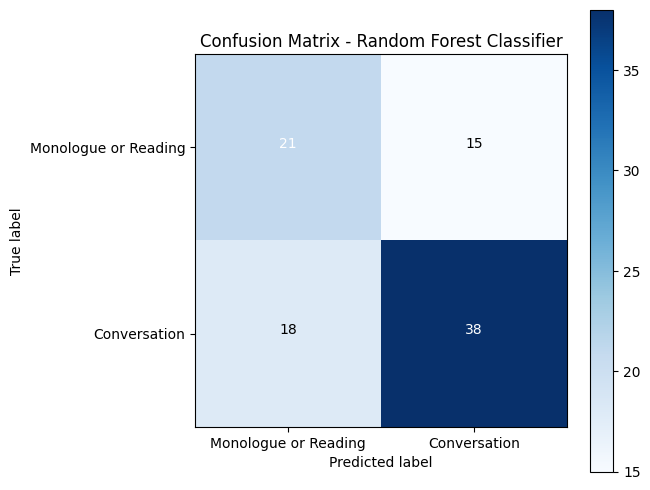

In [364]:
# Plot confusion matrix for the combined categories - SVM classifier
plot_binary_confusion_matrix(y_test_way2, y_pred_rf_way2, custom_classes_combined, 'Confusion Matrix - Random Forest Classifier')


## k-Nearest Neighbors Classifier

In [365]:
## k-Nearest Neighbors Classifier 

from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, mean_squared_error

# Train k-NN classifier
knn_classifier = KNeighborsClassifier(n_neighbors=5)
knn_classifier.fit(X_train_way2, y_train_way2)

# Predictions
y_pred_knn = knn_classifier.predict(X_test_way2)

# Calculate accuracy
accuracy_knn_way2 = accuracy_score(y_test_way2, y_pred_knn)
print("k-NN Classifier Accuracy:", accuracy_knn_way2)

# Calculate mean squared error (MSE)
mse_knn_way2 = mean_squared_error(y_test_way2, y_pred_knn)
print("k-NN Classifier Mean Squared Error (MSE):", mse_knn_way2)

k-NN Classifier Accuracy: 0.6195652173913043
k-NN Classifier Mean Squared Error (MSE): 0.3804347826086957


### Confusion matrix

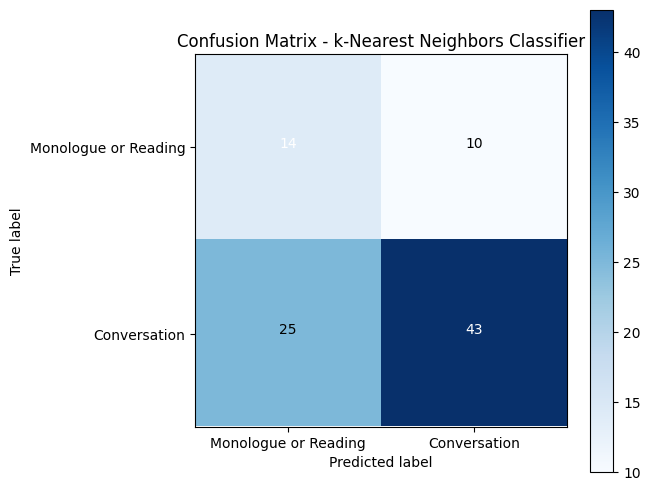

In [366]:
plot_binary_confusion_matrix(y_test_way2, y_pred_knn, custom_classes_combined, 'Confusion Matrix - k-Nearest Neighbors Classifier')

## Logistic Regression Classifier

In [367]:
#Logistic Regression Classifier

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, mean_squared_error

# Train logistic regression classifier with adjusted solver
logistic_classifier = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
logistic_classifier.fit(X_train_way2, y_train_way2)

# Predictions
y_pred_logistic = logistic_classifier.predict(X_test_way2)

# Calculate accuracy
accuracy_logistic_way2 = accuracy_score(y_test_way2, y_pred_logistic)
print("Logistic Regression Classifier Accuracy:", accuracy_logistic_way2)

# Calculate mean squared error (MSE)
mse_logistic_way2 = mean_squared_error(y_test_way2, y_pred_logistic)
print("Logistic Regression Classifier Mean Squared Error (MSE):", mse_logistic_way2)

Logistic Regression Classifier Accuracy: 0.7282608695652174
Logistic Regression Classifier Mean Squared Error (MSE): 0.2717391304347826


### Confusion matrix

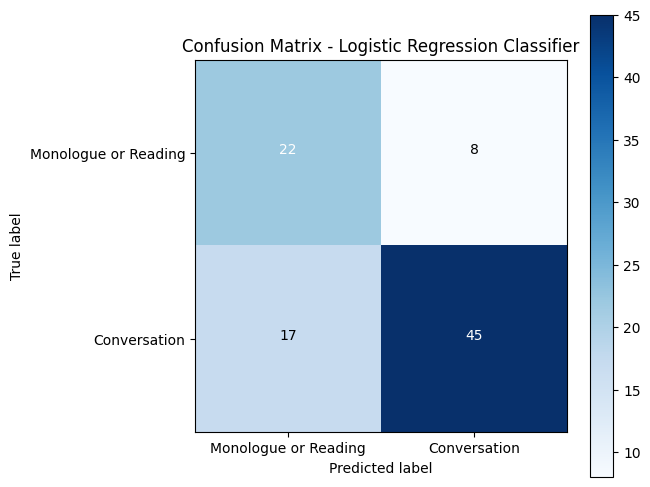

In [368]:
plot_binary_confusion_matrix(y_test_way2, y_pred_logistic, custom_classes_combined, 'Confusion Matrix - Logistic Regression Classifier')

## Accuracy bar plots

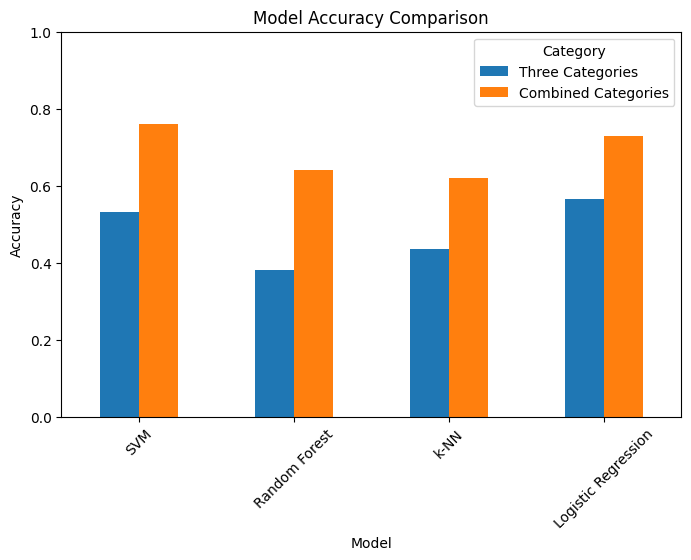

In [449]:
import matplotlib.pyplot as plt

# Accuracy scores for each model
accuracies = {
    'Model': ['SVM', 'Random Forest', 'k-NN', 'Logistic Regression'],
    'Three Categories': [accuracy_SVM_way1, accuracy_rf_way1, accuracy_knn_way1,accuracy_logistic_way1],
    'Combined Categories': [accuracy_SVM_way2 ,accuracy_rf_way2,accuracy_knn_way2, accuracy_logistic_way2]
}

# Create DataFrame for plotting
accuracy_df = pd.DataFrame(accuracies)

# Plotting
accuracy_df.plot(x='Model', kind='bar', figsize=(8, 5))
plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison')
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.legend(title='Category')
plt.show()

# Clustering - On the original data without standardizing

## K-means

In [370]:
#print(final_data_filtered ) 
#['monologue' 'conversation' 'reading']
#[0,1,2]
print(final_data_filtered["situation"].unique())

[0 1 2]


## choosing the optimal k by Elbow method

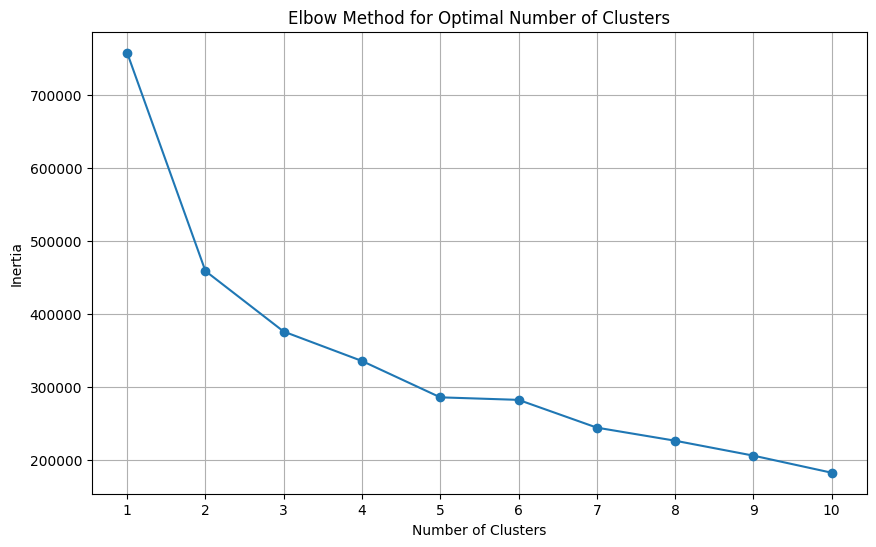

In [371]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Assuming final_data_filtered is a pandas DataFrame
# Extract the values from the DataFrame
data = final_data_filtered.values

# Define the range of potential number of clusters to try
clusters_range = range(1, 11)  # Try cluster numbers from 1 to 10

# Initialize an empty list to store the inertia (within-cluster sum of squared distances) for each cluster number
inertia = []

# Run KMeans for each number of clusters and store the inertia
for n_clusters in clusters_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(data)
    inertia.append(kmeans.inertia_)

# Plot the Elbow curve
plt.figure(figsize=(10, 6))
plt.plot(clusters_range, inertia, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.xticks(clusters_range)
plt.grid(True)
plt.show()

In [372]:
# Find the elbow point programmatically
def find_elbow_point(inertia):
    # Calculate the differences in inertia
    differences = np.diff(inertia)

    # Calculate the second derivative of the inertia
    second_derivative = np.diff(differences)

    # Find the index corresponding to the maximum second derivative
    elbow_index = np.argmax(second_derivative) + 1  # Add 1 to shift index by 1

    return elbow_index

# Find the index of the elbow point
elbow_index = find_elbow_point(inertia)

# Optimal number of clusters
optimal_n_clusters = elbow_index + 1  # Add 1 to shift index by 1

print("Optimal number of clusters:", optimal_n_clusters)

Optimal number of clusters: 2


### plot k=2 clusters

0    Cluster B
1    Cluster B
2    Cluster B
3    Cluster B
4    Cluster A
dtype: object
Principal Component 1 explains 13.56% of the variance.
Principal Component 2 explains 10.67% of the variance.


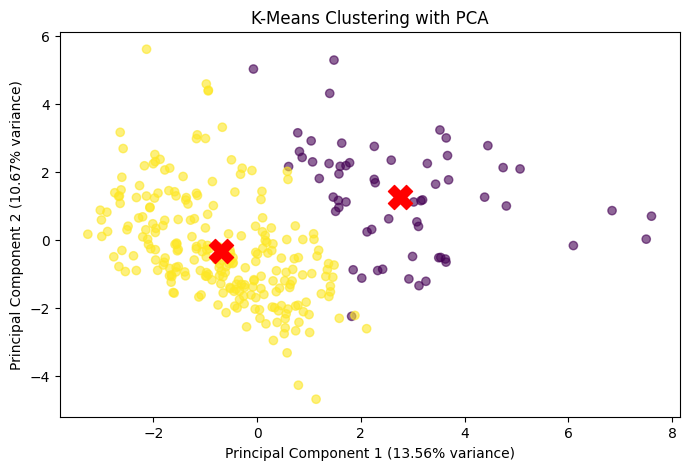

In [448]:
#******************************************* 
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assuming final_data_filtered is your DataFrame
# Identify numerical and categorical columns
numerical_features = final_data_filtered.select_dtypes(include=['int64', 'float64']).columns
categorical_features = final_data_filtered.select_dtypes(include=['object', 'category']).columns

# Preprocessing pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(), categorical_features)
    ]
)

# K-Means Clustering pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('kmeans', KMeans(n_clusters=2, random_state=42))
])

# Fit and predict clusters
clusters = pipeline.fit_predict(final_data_filtered)

# Mapping cluster numbers to meaningful names
cluster_names = {0: 'Cluster A', 1: 'Cluster B'}
cluster_name_variable_k2 = pd.Series(clusters).map(cluster_names)

# Print the first few entries of the cluster name variable
print(cluster_name_variable_k2.head())

# Adding the cluster labels to the DataFrame
final_data_filtered['Cluster'] = clusters 

final_data_filtered_way2_clusters = final_data_filtered_way2.copy()

final_data_filtered_way2_clusters["cluster"]=clusters 


#For stan

final_data_filtered_way2_clusters_stan = final_data_filtered_way2_stan.copy()

final_data_filtered_way2_clusters_stan["cluster"]=clusters 


# Applying PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
principal_components = pca.fit_transform(pipeline.named_steps['preprocessor'].transform(final_data_filtered.drop('Cluster', axis=1)))

# Get the explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Print the explained variance for each principal component
print(f"Principal Component 1 explains {explained_variance_ratio[0] * 100:.2f}% of the variance.")
print(f"Principal Component 2 explains {explained_variance_ratio[1] * 100:.2f}% of the variance.")

# Plotting the clusters in 2D
plt.figure(figsize=(8, 5))
plt.scatter(principal_components[:, 0], principal_components[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.scatter(pca.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 0], pca.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 1], s=300, c='red', marker='X')
plt.xlabel(f'Principal Component 1 ({explained_variance_ratio[0] * 100:.2f}% variance)')
plt.ylabel(f'Principal Component 2 ({explained_variance_ratio[1] * 100:.2f}% variance)')
plt.title('K-Means Clustering with PCA')
plt.show()

## 3D k=2

Principal Component 1 explains 13.56% of the variance.
Principal Component 2 explains 10.67% of the variance.
Principal Component 3 explains 8.35% of the variance.


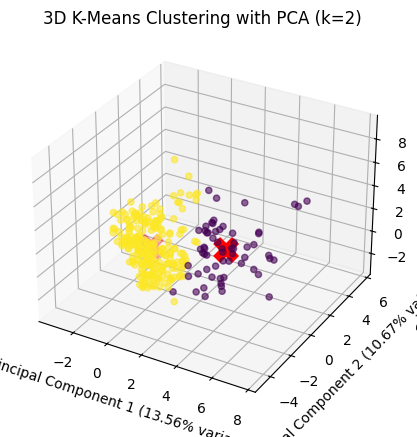

In [374]:
pca_3d = PCA(n_components=3)
principal_components_3d = pca_3d.fit_transform(pipeline.named_steps['preprocessor'].transform(final_data_filtered.drop('Cluster', axis=1)))

# Get the explained variance ratio for 3 components
explained_variance_ratio_3d = pca_3d.explained_variance_ratio_

# Print the explained variance for each principal component
print(f"Principal Component 1 explains {explained_variance_ratio_3d[0] * 100:.2f}% of the variance.")
print(f"Principal Component 2 explains {explained_variance_ratio_3d[1] * 100:.2f}% of the variance.")
print(f"Principal Component 3 explains {explained_variance_ratio_3d[2] * 100:.2f}% of the variance.")

# Plotting the clusters in 3D
fig = plt.figure(figsize=(8, 5))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(principal_components_3d[:, 0], principal_components_3d[:, 1], principal_components_3d[:, 2], c=clusters, cmap='viridis', alpha=0.6)
ax.scatter(pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 0], 
           pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 1], 
           pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 2], 
           s=300, c='red', marker='X')
ax.set_xlabel(f'Principal Component 1 ({explained_variance_ratio_3d[0] * 100:.2f}% variance)')
ax.set_ylabel(f'Principal Component 2 ({explained_variance_ratio_3d[1] * 100:.2f}% variance)')
ax.set_zlabel(f'Principal Component 3 ({explained_variance_ratio_3d[2] * 100:.2f}% variance)')
ax.set_title('3D K-Means Clustering with PCA (k=2)')
plt.show()

## 2D k=3

0    Cluster C
1    Cluster C
2    Cluster C
3    Cluster C
4    Cluster B
dtype: object
Principal Component 1 explains 13.56% of the variance.
Principal Component 2 explains 10.67% of the variance.


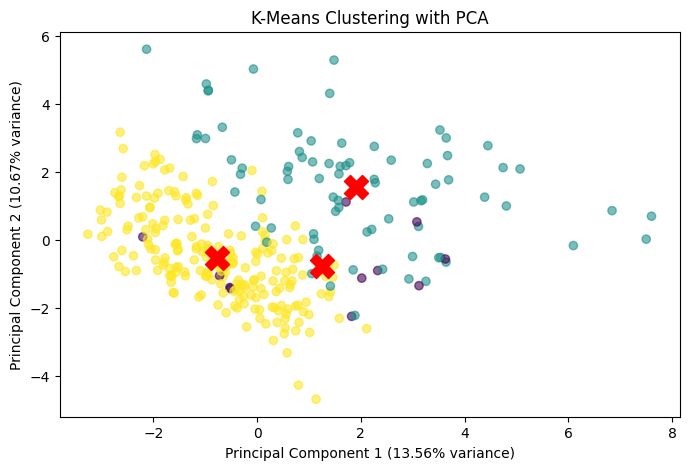

In [375]:
#*************************************** 
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assuming final_data_filtered is your DataFrame
# Identify numerical and categorical columns
numerical_features = final_data_filtered.select_dtypes(include=['int64', 'float64']).columns
categorical_features = final_data_filtered.select_dtypes(include=['object', 'category']).columns

# Preprocessing pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(), categorical_features)
    ]
)

# K-Means Clustering pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('kmeans', KMeans(n_clusters=3, random_state=42))
])

# Fit and predict clusters
clusters = pipeline.fit_predict(final_data_filtered)

# Mapping cluster numbers to meaningful names
cluster_names = {0: 'Cluster A', 1: 'Cluster B', 2: 'Cluster C'}
cluster_name_variable_k3 = pd.Series(clusters).map(cluster_names)

# Print the first few entries of the cluster name variable
print(cluster_name_variable_k3.head())

# Adding the cluster labels to the DataFrame
final_data_filtered['Cluster'] = clusters

# Applying PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
principal_components = pca.fit_transform(pipeline.named_steps['preprocessor'].transform(final_data_filtered.drop('Cluster', axis=1)))

# Get the explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Print the explained variance for each principal component
print(f"Principal Component 1 explains {explained_variance_ratio[0] * 100:.2f}% of the variance.")
print(f"Principal Component 2 explains {explained_variance_ratio[1] * 100:.2f}% of the variance.")

# Plotting the clusters in 2D
plt.figure(figsize=(8, 5))
plt.scatter(principal_components[:, 0], principal_components[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.scatter(pca.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 0], pca.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 1], s=300, c='red', marker='X')
plt.xlabel(f'Principal Component 1 ({explained_variance_ratio[0] * 100:.2f}% variance)')
plt.ylabel(f'Principal Component 2 ({explained_variance_ratio[1] * 100:.2f}% variance)')
plt.title('K-Means Clustering with PCA')
plt.show()

Principal Component 1 explains 13.56% of the variance.
Principal Component 2 explains 10.67% of the variance.
Principal Component 3 explains 8.35% of the variance.


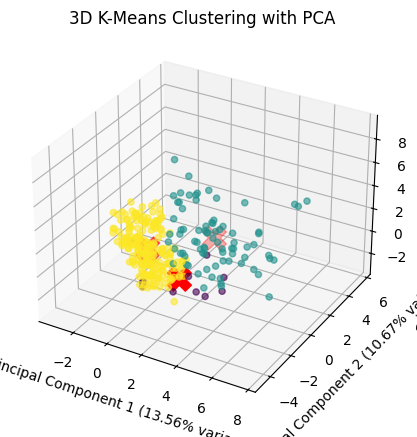

In [376]:
# Applying PCA to reduce dimensionality to 3 components
pca_3d = PCA(n_components=3)
principal_components_3d = pca_3d.fit_transform(pipeline.named_steps['preprocessor'].transform(final_data_filtered.drop('Cluster', axis=1)))

# Get the explained variance ratio for 3 components
explained_variance_ratio_3d = pca_3d.explained_variance_ratio_

# Print the explained variance for each principal component
print(f"Principal Component 1 explains {explained_variance_ratio_3d[0] * 100:.2f}% of the variance.")
print(f"Principal Component 2 explains {explained_variance_ratio_3d[1] * 100:.2f}% of the variance.")
print(f"Principal Component 3 explains {explained_variance_ratio_3d[2] * 100:.2f}% of the variance.")

# Plotting the clusters in 3D
fig = plt.figure(figsize=(8, 5))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(principal_components_3d[:, 0], principal_components_3d[:, 1], principal_components_3d[:, 2], c=clusters, cmap='viridis', alpha=0.6)
ax.scatter(pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 0], 
           pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 1], 
           pca_3d.transform(pipeline.named_steps['kmeans'].cluster_centers_)[:, 2], 
           s=300, c='red', marker='X')
ax.set_xlabel(f'Principal Component 1 ({explained_variance_ratio_3d[0] * 100:.2f}% variance)')
ax.set_ylabel(f'Principal Component 2 ({explained_variance_ratio_3d[1] * 100:.2f}% variance)')
ax.set_zlabel(f'Principal Component 3 ({explained_variance_ratio_3d[2] * 100:.2f}% variance)')
ax.set_title('3D K-Means Clustering with PCA')
plt.show()

Identifying Patterns:

Use the plot to identify patterns and relationships within your data. For instance, if certain clusters correspond to specific categories or segments in your data, you can gain insights into the characteristics of those segments.
Assessing Clustering Quality:

The plot helps assess the quality of the clustering. Well-separated clusters suggest good clustering, while overlapping clusters might indicate the need for further investigation.
Dimensionality Reduction:

PCA helps visualize high-dimensional data in a two-dimensional space, making it easier to understand and interpret.

### Principal Component 1 (PC1) and Principal Component 2 (PC2) are linear combinations of your original features. They represent directions in the feature space that capture the maximum variance.

## Adding chi-square test

In [377]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from scipy.stats import chi2_contingency  # Ensure this import statement is present
import matplotlib.pyplot as plt
# Define the mapping dictionary for situations
mapping = {
    0: 'monologue',
    1: 'conversation',
    2: 'reading'
}

# Create a new list with the mapped names for situations
situations_in_dat = [mapping[value] for value in final_data_filtered["situation"]]

# Create a new list with the mapped names for situations in way 2
mapping_way2 = {
    0: 'monologue_reading',
    1: 'conversation',
    2: 'monologue_reading'
}
situations_in_dat_way2 = [mapping_way2[value] for value in final_data_filtered["situation"]]

# Contingency tables
contingency_table_k2 = pd.crosstab(cluster_name_variable_k2, situations_in_dat)
contingency_table_k3 = pd.crosstab(cluster_name_variable_k3, situations_in_dat_way2)

# Chi-square tests
chi2_k2, p_k2, dof_k2, ex_k2 = chi2_contingency(contingency_table_k2)
chi2_k3, p_k3, dof_k3, ex_k3 = chi2_contingency(contingency_table_k3)

# Convert expected frequencies to DataFrame for better visualization
ex_k2_df = pd.DataFrame(ex_k2, index=contingency_table_k2.index, columns=contingency_table_k2.columns)
ex_k3_df = pd.DataFrame(ex_k3, index=contingency_table_k3.index, columns=contingency_table_k3.columns)

# Print the contingency tables
print("Contingency Table for k=2 Clusters:")
print(contingency_table_k2)
print("\nContingency Table for k=3 Clusters:")
print(contingency_table_k3)

# Print the chi-square test results
print("\nChi-Square Test for k=2 Clusters:")
print(f"Chi2 Statistic: {chi2_k2}")
print(f"p-value: {p_k2}")
print(f"Degrees of Freedom: {dof_k2}")
print("\nExpected Frequencies:")
print(ex_k2_df)

print("\nChi-Square Test for k=3 Clusters:")
print(f"Chi2 Statistic: {chi2_k3}")
print(f"p-value: {p_k3}")
print(f"Degrees of Freedom: {dof_k3}")
print("\nExpected Frequencies:")
print(ex_k3_df)

Contingency Table for k=2 Clusters:
col_0      conversation  monologue  reading
row_0                                      
Cluster A            25         12       24
Cluster B           101         65       78

Contingency Table for k=3 Clusters:
col_0      conversation  monologue_reading
row_0                                     
Cluster A            11                  0
Cluster B            27                 52
Cluster C            88                127

Chi-Square Test for k=2 Clusters:
Chi2 Statistic: 1.7344134623546388
p-value: 0.42012342947466574
Degrees of Freedom: 2

Expected Frequencies:
col_0      conversation  monologue  reading
row_0                                      
Cluster A          25.2       15.4     20.4
Cluster B         100.8       61.6     81.6

Chi-Square Test for k=3 Clusters:
Chi2 Statistic: 17.298318138453126
p-value: 0.00017527417965264105
Degrees of Freedom: 2

Expected Frequencies:
col_0      conversation  monologue_reading
row_0                     

## Hierarchical Clustering - dendogram

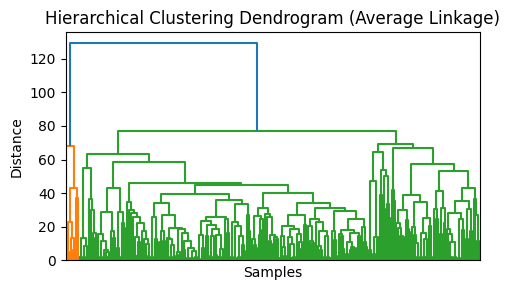

In [378]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import pandas as pd

# Assuming final_data_filtered is your DataFrame with preprocessed data

# Calculate the linkage matrix using average linkage
linkage_matrix_av = linkage(final_data_filtered, method='average', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(5, 3))
dendrogram(linkage_matrix_av, leaf_rotation=90, leaf_font_size=10)
plt.title('Hierarchical Clustering Dendrogram (Average Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.xticks(ticks=[], labels=[])
plt.tight_layout()
plt.show()

In [379]:
from scipy.cluster.hierarchy import fcluster

# Determine the number of clusters you want
num_clusters = 3

# Cut the dendrogram to obtain clusters
clusters = fcluster(linkage_matrix_av, num_clusters, criterion='maxclust')

# Print the cluster assignments
print(clusters)

[2 2 2 2 3 2 2 2 2 3 3 2 2 2 2 2 2 1 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 1
 3 2 2 2 3 3 1 1 3 3 3 3 3 2 2 2 2 2 2 2 2 3 3 2 3 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 3 3 3 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 3 2 2
 2 2 3 3 2 2 2 2 3 3 3 3 3 3 2 2 2 2 3 3 1 2 2 3 2 3 3 2 2 2 2 2 3 2 2 2 2
 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 2 2 2 2 2 2 3 2 2 2 2 3 3 3 3 3 2
 2 3 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3 3 3 3 2 2 3 3 3 3 3 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 3 3 2 2 2 1 1 1 1 2 2 3 2
 3 3 1 2 2 2 2 3 3 2 2 3 2 3 2 3 3 3 3 2 3 3 3 3 3 3 3 3 2 2 3 2 2 2 2 2 3
 2 2 2 2 2 2 2 2 2]


In [380]:
len(clusters)

305

so cluster variable gives us the clustered group, then we will see if this relevant with the situations that we have

In [381]:
print(final_data_filtered["situation"])

0      0
1      0
2      0
3      0
4      0
      ..
300    2
301    2
302    2
303    2
304    2
Name: situation, Length: 305, dtype: int64


In [382]:

# Define the mapping dictionary
mapping = {
    0: 'monologue',
    1: 'conversation',
    2: 'reading'
}

# Create a new list with the mapped names
situations_in_dat = [mapping[value] for value in final_data_filtered["situation"]]

print(situations_in_dat)

['monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue', 'monologue'

1.Creating Contingency Table:  a contingency table where rows represent the cluster labels and columns represent the situation labels. Each cell in the table contains the count of data points belonging to a particular combination of cluster and situation.        
2.Chi-square Test: using the Chi-square test to determine whether there is a significant association between the cluster labels and the situation labels. This test evaluates whether the observed frequencies in the contingency table differ significantly from the frequencies expected under the assumption of independence between the variables.

In [383]:
from scipy.stats import chi2_contingency

# Assuming 'clusters' and 'situations' are the vectors of cluster labels and situation labels
# Create a contingency table
contingency_table = pd.crosstab(clusters, situations_in_dat)

# Perform Chi-square test
chi2, p, dof, expected = chi2_contingency(contingency_table)

print("Chi-square statistic:", chi2)
print("p-value:", p)

Chi-square statistic: 9.636659157588895
p-value: 0.047013693332743876


The p-value (0.196) is the probability of observing a chi-square statistic as extreme as the one calculated, assuming that the null hypothesis is true (i.e., assuming there is no association between the variables).

### Single method

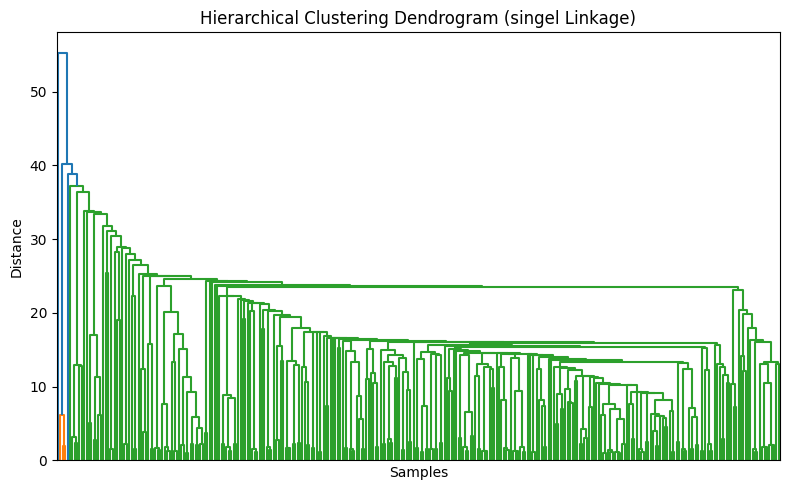

In [384]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import pandas as pd

# Assuming final_data_filtered is your DataFrame with preprocessed data

# Calculate the linkage matrix using average linkage
linkage_matrix_single = linkage(final_data_filtered, method='single', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(8, 5))
dendrogram(linkage_matrix_single, leaf_rotation=90, leaf_font_size=10)
plt.title('Hierarchical Clustering Dendrogram (singel Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.xticks(ticks=[], labels=[])
plt.tight_layout()
plt.show()

In [385]:
from scipy.cluster.hierarchy import fcluster

# Determine the number of clusters you want
num_clusters = 3

# Cut the dendrogram to obtain clusters
clusters_single = fcluster(linkage_matrix_single, num_clusters, criterion='maxclust')

# Print the cluster assignments
print(clusters)

[2 2 2 2 3 2 2 2 2 3 3 2 2 2 2 2 2 1 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 1
 3 2 2 2 3 3 1 1 3 3 3 3 3 2 2 2 2 2 2 2 2 3 3 2 3 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 3 3 3 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 3 2 2
 2 2 3 3 2 2 2 2 3 3 3 3 3 3 2 2 2 2 3 3 1 2 2 3 2 3 3 2 2 2 2 2 3 2 2 2 2
 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 2 2 2 2 2 2 3 2 2 2 2 3 3 3 3 3 2
 2 3 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3 3 3 3 2 2 3 3 3 3 3 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 3 3 2 2 2 1 1 1 1 2 2 3 2
 3 3 1 2 2 2 2 3 3 2 2 3 2 3 2 3 3 3 3 2 3 3 3 3 3 3 3 3 2 2 3 2 2 2 2 2 3
 2 2 2 2 2 2 2 2 2]


In [386]:
from scipy.stats import chi2_contingency

# Assuming 'clusters' and 'situations' are the vectors of cluster labels and situation labels
# Create a contingency table
contingency_table = pd.crosstab(clusters_single, situations_in_dat)

# Perform Chi-square test
chi2, p, dof, expected = chi2_contingency(contingency_table)

print("Chi-square statistic:", chi2)
print("p-value:", p)

Chi-square statistic: 4.762627625633294
p-value: 0.3125316681593818


## complete

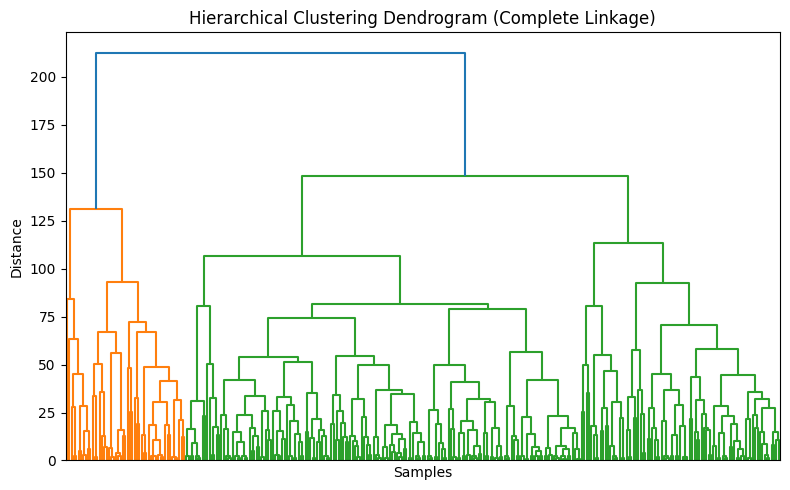

In [387]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import pandas as pd

# Assuming final_data_filtered is your DataFrame with preprocessed data

# Calculate the linkage matrix using average linkage
linkage_matrix_comp = linkage(final_data_filtered, method='complete', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(8, 5))
dendrogram(linkage_matrix_comp, leaf_rotation=90, leaf_font_size=10)
plt.title('Hierarchical Clustering Dendrogram (Complete Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.xticks(ticks=[], labels=[])
plt.tight_layout()
plt.show()

In [388]:
from scipy.cluster.hierarchy import fcluster

# Determine the number of clusters you want
num_clusters = 3

# Cut the dendrogram to obtain clusters
clusters_comp = fcluster(linkage_matrix_comp, num_clusters, criterion='maxclust')

# Print the cluster assignments
print(clusters_comp)

[2 2 2 2 1 2 2 2 2 1 1 2 3 2 2 2 2 1 3 2 2 3 2 2 3 2 2 2 3 2 2 2 2 2 2 2 1
 3 2 2 2 1 1 1 1 3 3 3 3 3 3 3 3 2 2 2 2 2 3 1 2 3 2 2 2 2 2 2 2 2 2 2 3 2
 2 2 2 3 3 1 1 2 2 2 2 2 2 2 3 1 3 3 2 2 2 2 3 3 3 2 2 2 2 3 1 2 2 3 3 2 3
 3 3 3 1 2 2 2 2 3 3 3 3 3 1 2 2 2 2 3 1 1 2 2 3 2 1 1 2 2 2 2 2 3 2 2 2 2
 3 3 3 1 2 2 3 2 3 3 2 2 2 2 2 3 2 2 3 3 3 3 2 2 2 2 3 3 2 2 2 3 1 1 3 1 2
 3 3 3 2 2 2 3 2 2 3 2 2 2 2 2 3 2 3 1 1 1 1 1 1 2 3 3 3 1 1 1 2 2 2 2 2 2
 3 2 3 3 2 2 2 2 2 2 3 3 3 2 2 2 2 2 2 2 2 2 2 2 1 1 2 2 2 1 1 1 1 2 2 1 2
 1 1 1 3 3 2 2 3 3 2 2 3 3 1 2 3 1 1 1 2 3 3 3 3 1 1 1 1 2 2 3 2 2 2 2 2 3
 2 2 2 3 2 2 2 2 2]


In [389]:
from scipy.stats import chi2_contingency

# Assuming 'clusters' and 'situations' are the vectors of cluster labels and situation labels
# Create a contingency table
contingency_table = pd.crosstab(clusters_comp, situations_in_dat)

# Perform Chi-square test
chi2, p, dof, expected = chi2_contingency(contingency_table)

print("Chi-square statistic:", chi2)
print("p-value:", p)

Chi-square statistic: 15.29257080521387
p-value: 0.004131331168472675


## NOT IMPORTANT We will see if we determine the number of clusters to 2, whether these significantly dependent with the 2 catigories situations

In [390]:
# Determine the number of clusters you want
num_clusters_2 = 2

# Cut the dendrogram to obtain clusters
clusters_2 = fcluster(linkage_matrix_av, num_clusters_2, criterion='maxclust')

# Print the cluster assignments
print(clusters_2)

[2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1
 2 2 2 2 2 2 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 1 1 2 2 2 2
 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2]


In [391]:
mapping_way2 = {
    0: 'monologue_reading',
    1: 'conversation',
    2: 'monologue_reading'
}

# Create a new list with the mapped names
situations_in_dat_way2 = [mapping_way2[value] for value in final_data_filtered["situation"]]
print(situations_in_dat_way2)

['monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_reading', 'monologue_r

In [392]:
# Assuming 'clusters' and 'situations' are the vectors of cluster labels and situation labels
# Create a contingency table
contingency_table_2 = pd.crosstab(clusters_2, situations_in_dat_way2)

# Perform Chi-square test
chi2_way2, p_2, dof, expected = chi2_contingency(contingency_table_2)

print("Chi-square statistic:", chi2_way2)
print("p-value:", p_2)

Chi-square statistic: 2.9521901673272284
p-value: 0.08576125968378047


## Discribtive statistic for each feature

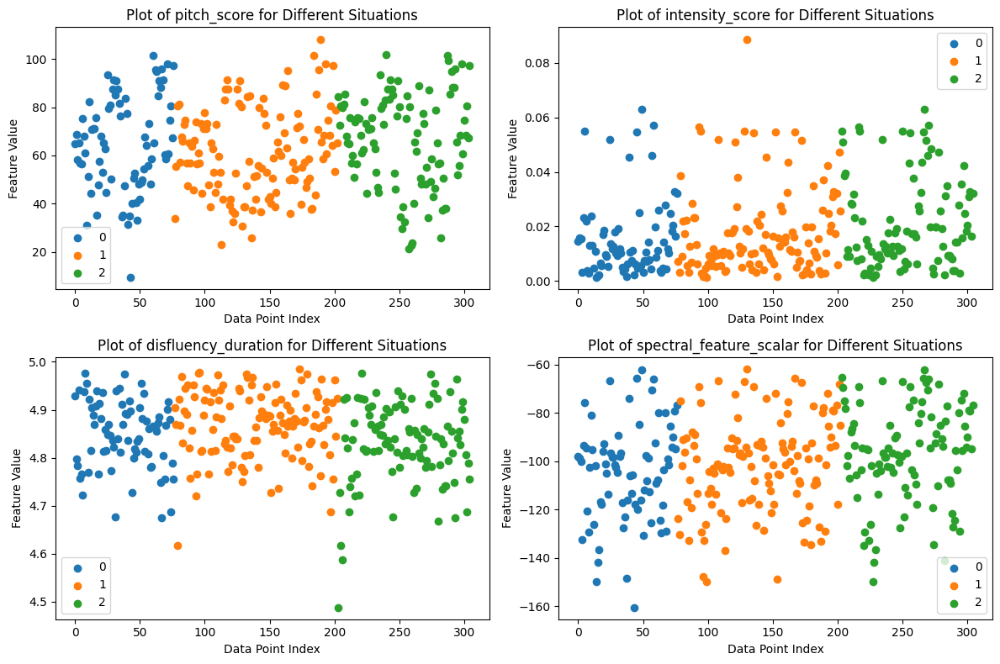

In [393]:
import matplotlib.pyplot as plt

# List of features to plot
features = ['pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']

plt.figure(figsize=(12, 8))

# Plotting for each feature
for i, feature in enumerate(features, start=1):
    plt.subplot(2, 2, i)
    
    # Iterate over each category in the 'situation' variable
    for category in final_data_filtered['situation'].unique():
        # Filter the data for the current category
        data = final_data_filtered[final_data_filtered['situation'] == category]
        # Plot the feature against the index (assuming the index represents data points)
        plt.scatter(data.index, data[feature], label=category)

    # Add labels and legend
    plt.xlabel('Data Point Index')
    plt.ylabel('Feature Value')
    plt.title(f'Plot of {feature} for Different Situations')
    plt.legend()

plt.tight_layout()
plt.show()

## As we did the final machine learning on the combined data, then we will continue with that data-set , with adding the features as a variables and the cluster number too.

#### 1. Adding the clustering for optimal k=2 2D
#### 2. Adding the histograms
#### 3. Adding a new clusters variables to the data(combined) then applying machine learning methods and compare with machine learning on combined data

In [396]:
#final_data_filtered_way2 
print(final_data_filtered_way2_clusters)
final_data_filtered_way2_clusters.columns

     gender  handedness  family_history  age_at_onset  age_at_recording  \
0         0           0               0     36.000000               135   
1         0           0               0     36.000000               137   
2         0           0               0     36.000000               139   
3         0           0               0     36.000000               144   
4         0           0               0     60.000000               191   
..      ...         ...             ...           ...               ...   
300       1           0               2     66.000000               135   
301       1           0               1     60.000000               135   
302       1           0               2     56.921212               140   
303       1           0               1     56.921212               132   
304       1           0               2     84.000000               133   

     where_recorded  recording_conditions  type_of_therapy  \
0                 0                  

Index(['gender', 'handedness', 'family_history', 'age_at_onset',
       'age_at_recording', 'where_recorded', 'recording_conditions',
       'type_of_therapy', 'time_between_therapy_and_recording',
       'hearing_problems', 'language_problems', 'sen', 'orthographic',
       'phonetic', 'time_aligned', 'tape_noise', 'env_noise',
       'speaker_quality', 'interruptions', 'situation', 'audio_score',
       'pitch_score', 'intensity_score', 'disfluency_duration',
       'spectral_feature_scalar', 'phl', 'Cluster', 'cluster'],
      dtype='object')

In [397]:
print(final_data_filtered_way2)

     gender  handedness  family_history  age_at_onset  age_at_recording  \
0         0           0               0     36.000000               135   
1         0           0               0     36.000000               137   
2         0           0               0     36.000000               139   
3         0           0               0     36.000000               144   
4         0           0               0     60.000000               191   
..      ...         ...             ...           ...               ...   
300       1           0               2     66.000000               135   
301       1           0               1     60.000000               135   
302       1           0               2     56.921212               140   
303       1           0               1     56.921212               132   
304       1           0               2     84.000000               133   

     where_recorded  recording_conditions  type_of_therapy  \
0                 0                  

## Histograms for features variables, in different clusters

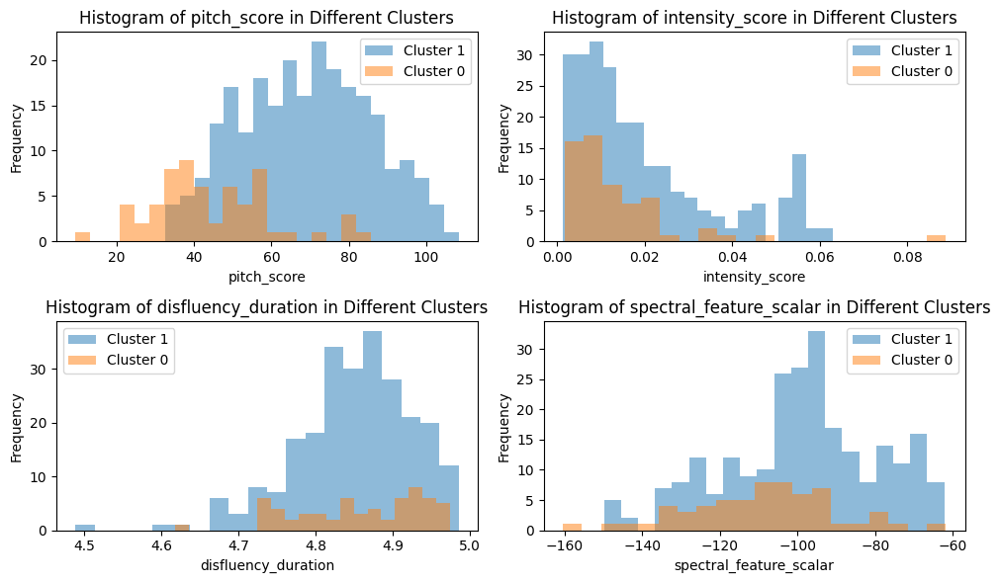

In [398]:
import matplotlib.pyplot as plt

# Define the variables of interest and the clusters
variables_of_interest = ['pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
clusters = final_data_filtered_way2_clusters['cluster'].unique()

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 6))

# Loop over each variable and plot in the corresponding subplot
for i, variable in enumerate(variables_of_interest):
    row = i // 2  # Row index for subplot
    col = i % 2   # Column index for subplot
    ax = axes[row, col]  # Get the corresponding axis
    ax.set_title(f'Histogram of {variable} in Different Clusters')
    for cluster in clusters:
        # Filter data for the current cluster
        data_cluster = final_data_filtered_way2_clusters[final_data_filtered_way2_clusters['cluster'] == cluster]
        # Plot histogram for the current variable in the current cluster
        ax.hist(data_cluster[variable], bins=20, alpha=0.5, label=f'Cluster {cluster}')
    ax.set_xlabel(variable)
    ax.set_ylabel('Frequency')
    ax.legend()

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

In [399]:
## Map 'monologue' and 'reading' to 0, and 'conversation' to 1

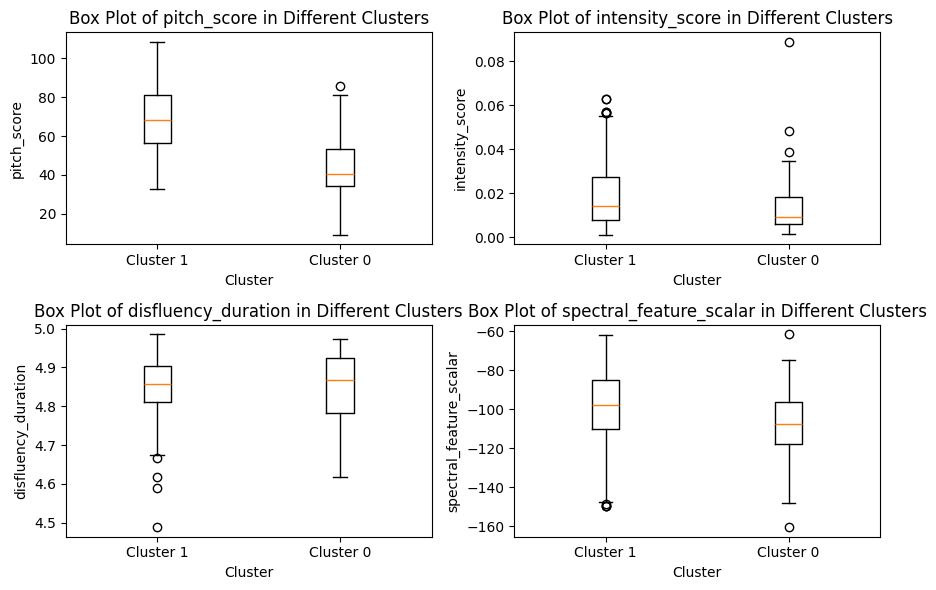

In [400]:
import matplotlib.pyplot as plt

# Define the variables of interest and the clusters
variables_of_interest = ['pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
clusters = final_data_filtered_way2_clusters['cluster'].unique()

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(9, 6))

# Loop over each variable and plot in the corresponding subplot
for i, variable in enumerate(variables_of_interest):
    row = i // 2  # Row index for subplot
    col = i % 2   # Column index for subplot
    ax = axes[row, col]  # Get the corresponding axis
    ax.set_title(f'Box Plot of {variable} in Different Clusters')
    # Create a list to store boxplot data for each cluster
    boxplot_data = []
    for cluster in clusters:
        # Filter data for the current cluster
        data_cluster = final_data_filtered_way2_clusters[final_data_filtered_way2_clusters['cluster'] == cluster]
        # Add data for the current cluster to the list
        boxplot_data.append(data_cluster[variable])
    # Plot boxplot for the current variable in the current subplot
    ax.boxplot(boxplot_data, labels=[f'Cluster {cluster}' for cluster in clusters])
    ax.set_xlabel('Cluster')
    ax.set_ylabel(variable)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

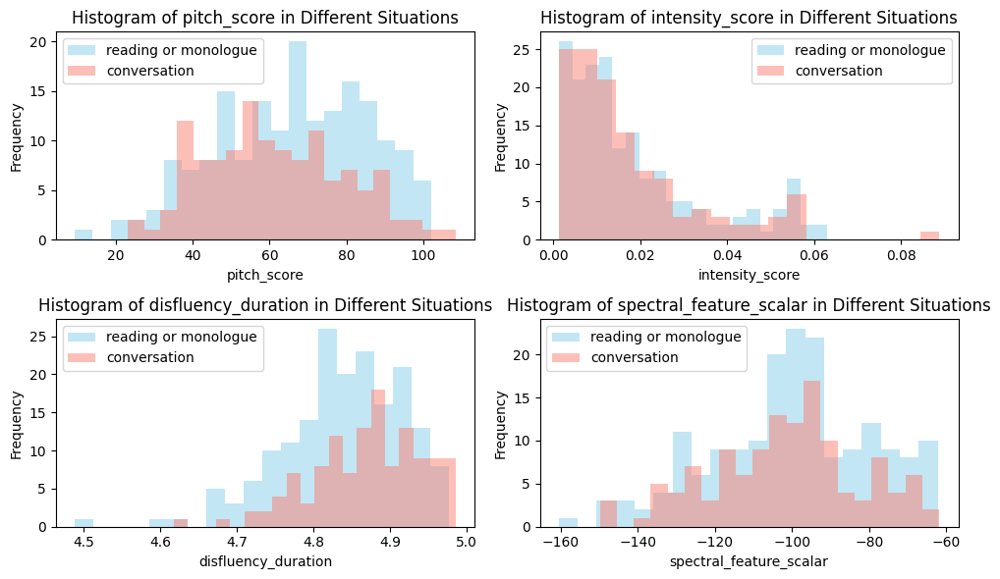

In [431]:
import matplotlib.pyplot as plt

# Define the variables of interest and the clusters
variables_of_interest = ['pitch_score', 'intensity_score', 'disfluency_duration', 'spectral_feature_scalar']
situations = final_data_filtered_way2_clusters['situation'].unique()
situation_labels = {0: 'reading or monologue', 1: 'conversation'}  # Define the mapping

# Define custom colors for the histograms
colors = ['skyblue', 'salmon']

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 6))

# Loop over each variable and plot in the corresponding subplot
for i, variable in enumerate(variables_of_interest):
    row = i // 2  # Row index for subplot
    col = i % 2   # Column index for subplot
    ax = axes[row, col]  # Get the corresponding axis
    ax.set_title(f'Histogram of {variable} in Different Situations')
    for situation in situations:
        # Filter data for the current situation
        data_situation = final_data_filtered_way2_clusters[final_data_filtered_way2_clusters['situation'] == situation]
        # Plot histogram for the current variable in the current situation
        ax.hist(data_situation[variable], bins=20, alpha=0.5, label=situation_labels[situation], color=colors[situation])
    ax.set_xlabel(variable)
    ax.set_ylabel('Frequency')
    ax.legend()

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

### Machine learning on the data with cluster variables (combined data)

In [ ]:
#final_data_filtered_way2_clusters_stan

In [421]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Dividing the data into train and test
X = final_data_filtered_way2_clusters_stan.drop(columns=['situation'])  # Features
y = final_data_filtered_way2_clusters_stan['situation']  # Labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize dictionaries to store accuracy values
accuracy_dict = {}
mean_cv_score_dict = {}
std_cv_score_dict = {}

# SVM 
svm_classifier = SVC(kernel='linear')
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)
accuracy_dict['SVM'] = accuracy_score(y_test, y_pred_svm)

# Cross-validation for SVM
cv_scores_svm = cross_val_score(svm_classifier, X, y, cv=5)
mean_cv_score_dict['SVM'] = cv_scores_svm.mean()
std_cv_score_dict['SVM'] = cv_scores_svm.std()

# Random Forest
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
accuracy_dict['Random Forest'] = accuracy_score(y_test, y_pred_rf)

# Cross-validation for Random Forest
cv_scores_rf = cross_val_score(rf_classifier, X, y, cv=5)
mean_cv_score_dict['Random Forest'] = cv_scores_rf.mean()
std_cv_score_dict['Random Forest'] = cv_scores_rf.std()

# KNN
knn_classifier = KNeighborsClassifier(n_neighbors=5)
knn_classifier.fit(X_train, y_train)
y_pred_knn = knn_classifier.predict(X_test)
accuracy_dict['KNN'] = accuracy_score(y_test, y_pred_knn)

# Cross-validation for KNN
cv_scores_knn = cross_val_score(knn_classifier, X, y, cv=5)
mean_cv_score_dict['KNN'] = cv_scores_knn.mean()
std_cv_score_dict['KNN'] = cv_scores_knn.std()

# Logistic Regression
logistic_classifier = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
logistic_classifier.fit(X_train, y_train)
y_pred_logistic = logistic_classifier.predict(X_test)
accuracy_dict['Logistic Regression'] = accuracy_score(y_test, y_pred_logistic)

# Cross-validation for Logistic Regression
cv_scores_logistic = cross_val_score(logistic_classifier, X, y, cv=5)
mean_cv_score_dict['Logistic Regression'] = cv_scores_logistic.mean()
std_cv_score_dict['Logistic Regression'] = cv_scores_logistic.std()

# Create DataFrame from accuracy dictionary
accuracy_df = pd.DataFrame(accuracy_dict.items(), columns=['Model', 'Accuracy (Train/Test)'])
accuracy_df['Mean CV Score'] = mean_cv_score_dict.values()
accuracy_df['Std CV Score'] = std_cv_score_dict.values()

# Display the DataFrame
print(accuracy_df)

                 Model  Accuracy (Train/Test)  Mean CV Score  Std CV Score
0                  SVM               0.760870       0.672131      0.054863
1        Random Forest               0.641304       0.619672      0.053272
2                  KNN               0.619565       0.632787      0.057354
3  Logistic Regression               0.728261       0.659016      0.059016


### without clusters variable

In [420]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Dividing the data into train and test
X = final_data_filtered_way2_stan.drop(columns=['situation'])  # Features
y = final_data_filtered_way2_stan['situation']  # Labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize dictionaries to store accuracy values
accuracy_dict = {}
mean_cv_score_dict = {}
std_cv_score_dict = {}

# SVM 
svm_classifier = SVC(kernel='linear')
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)
accuracy_dict['SVM'] = accuracy_score(y_test, y_pred_svm)

# Cross-validation for SVM
cv_scores_svm = cross_val_score(svm_classifier, X, y, cv=5)
mean_cv_score_dict['SVM'] = cv_scores_svm.mean()
std_cv_score_dict['SVM'] = cv_scores_svm.std()

# Random Forest
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
accuracy_dict['Random Forest'] = accuracy_score(y_test, y_pred_rf)

# Cross-validation for Random Forest
cv_scores_rf = cross_val_score(rf_classifier, X, y, cv=5)
mean_cv_score_dict['Random Forest'] = cv_scores_rf.mean()
std_cv_score_dict['Random Forest'] = cv_scores_rf.std()

# KNN
knn_classifier = KNeighborsClassifier(n_neighbors=5)
knn_classifier.fit(X_train, y_train)
y_pred_knn = knn_classifier.predict(X_test)
accuracy_dict['KNN'] = accuracy_score(y_test, y_pred_knn)

# Cross-validation for KNN
cv_scores_knn = cross_val_score(knn_classifier, X, y, cv=5)
mean_cv_score_dict['KNN'] = cv_scores_knn.mean()
std_cv_score_dict['KNN'] = cv_scores_knn.std()

# Logistic Regression
logistic_classifier = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
logistic_classifier.fit(X_train, y_train)
y_pred_logistic = logistic_classifier.predict(X_test)
accuracy_dict['Logistic Regression'] = accuracy_score(y_test, y_pred_logistic)

# Cross-validation for Logistic Regression
cv_scores_logistic = cross_val_score(logistic_classifier, X, y, cv=5)
mean_cv_score_dict['Logistic Regression'] = cv_scores_logistic.mean()
std_cv_score_dict['Logistic Regression'] = cv_scores_logistic.std()

# Create DataFrame from accuracy dictionary
accuracy_df = pd.DataFrame(accuracy_dict.items(), columns=['Model', 'Accuracy (Train/Test)'])
accuracy_df['Mean CV Score'] = mean_cv_score_dict.values()
accuracy_df['Std CV Score'] = std_cv_score_dict.values()

# Display the DataFrame
print(accuracy_df)

                 Model  Accuracy (Train/Test)  Mean CV Score  Std CV Score
0                  SVM               0.750000       0.665574      0.051424
1        Random Forest               0.641304       0.652459      0.052254
2                  KNN               0.619565       0.636066      0.054272
3  Logistic Regression               0.728261       0.659016      0.059016


## With 3 situations(before combining)-way A

In [437]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Dividing the data into train and test
X = final_data_filtered_stan.drop(columns=['situation'])  # Features
y = final_data_filtered_stan['situation']  # Labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize dictionaries to store metrics
accuracy_dict = {}
mean_cv_score_dict = {}
std_cv_score_dict = {}

# Function to perform training, prediction, and cross-validation
def evaluate_model(model, model_name):
    # Train the model
    model.fit(X_train, y_train)
    # Predictions
    y_pred = model.predict(X_test)
    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    # Cross-validation
    cv_scores = cross_val_score(model, X, y, cv=5)
    mean_cv_score = cv_scores.mean()
    std_cv_score = cv_scores.std()
    
    # Store metrics in dictionaries
    accuracy_dict[model_name] = accuracy
    mean_cv_score_dict[model_name] = mean_cv_score
    std_cv_score_dict[model_name] = std_cv_score

# SVM
svm_classifier = SVC(kernel='linear')
evaluate_model(svm_classifier, 'SVM')

# Random Forest
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
evaluate_model(rf_classifier, 'Random Forest')

# KNN
knn_classifier = KNeighborsClassifier(n_neighbors=5)
evaluate_model(knn_classifier, 'KNN')

# Logistic Regression
logistic_classifier = LogisticRegression(multi_class='multinomial', solver='saga', max_iter=2000)
evaluate_model(logistic_classifier, 'Logistic Regression')

# Create DataFrame from the dictionaries
results_df = pd.DataFrame({
    'Model': accuracy_dict.keys(),
    'Accuracy (Train/Test)': accuracy_dict.values(),
    'Mean CV Score': mean_cv_score_dict.values(),
    'Std CV Score': std_cv_score_dict.values()
})

# Display the DataFrame
print(results_df)

                 Model  Accuracy (Train/Test)  Mean CV Score  Std CV Score
0                  SVM               0.532609       0.550820      0.069242
1        Random Forest               0.380435       0.534426      0.087732
2                  KNN               0.434783       0.445902      0.097482
3  Logistic Regression               0.565217       0.537705      0.090030
